In [1]:
from tqdm import tqdm_notebook as tqdm

In [2]:
import numpy as np
import pandas as pd
from glob import glob as glob

In [3]:
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, RobustScaler, PowerTransformer, QuantileTransformer
from sklearn.model_selection import ParameterGrid, KFold

In [4]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
tf.__version__

'2.2.0'

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
sns.set_context('notebook')

/anaconda3/envs/neuro/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# 1. Data Preparation

In [6]:
# Load target values and corresponding scaler
targets = pd.read_csv('datasets/targets.csv')
targets = targets.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')
feature_transform = True

import joblib
scaler_targets = joblib.load('datasets/targets_scaler.pkl')

In [7]:
# Extract ID for train and test set
train_id = targets.index.values
sample_submission = pd.read_csv('sample_submission.csv')
test_id = np.unique(sample_submission.Id.str.split('_', expand=True)[0].astype('int'))

# 2. Modeling

In [8]:
def load_dataset(dataset_id, target):

    # Load dataset
    X_tr = pd.read_csv('datasets/%s_train.csv' % dataset_id)
    X_te = pd.read_csv('datasets/%s_test.csv' % dataset_id).drop(columns='Id').values

    # Specify target
    y = pd.read_csv('datasets/targets.csv')
    y = y.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')
    y_tr = y.iloc[X_tr.index][target]

    # Remove missing values
    missval = y_tr.isnull().values
    idx = ~missval
    X_tr = X_tr[idx].drop(columns='Id').values
    y_tr = y_tr[idx].values
    print('Removing %s missing values from target dataset.' % missval.sum())
    
    return X_tr, X_te, y_tr, idx

In [9]:
class CustomLoss(keras.losses.Loss):
    def __init__(self, scale=1, mean=0, tidx=0, name="custom_loss"):
        super().__init__(name=name)
        self.scale = np.array(scale, dtype='float32')
        self.mean = np.array(mean, dtype='float32')
        self.tidx = tidx

    @tf.function
    def call(self, y_true, y_pred):
        y_true = tf.math.add(tf.math.scalar_mul(self.scale, y_true), self.mean)
        y_pred = tf.math.add(tf.math.scalar_mul(self.scale, y_pred), self.mean)
        if self.tidx > 0:
            y_true = tf.math.pow(y_true, 1./1.5)
            y_pred = tf.math.pow(y_pred, 1./1.5)
        score = tf.math.divide(tf.math.reduce_sum(tf.math.abs(y_true - y_pred)), tf.math.reduce_sum(y_true))
        return score

In [10]:
def build_model(input_size=100,
                num_targets=1,
                activation='relu',
                dropout=0.5,
                kernel_initializer='glorot_uniform',
                optimizer='adam',
                tidx=0,
                use_batch=True,
                use_dropout=True,
                hidden=(32, 16)):

    # Specify layer structure
    inputs = keras.Input(shape=input_size)
    
    for i, h in enumerate(hidden):
        if i==0:
            x = layers.Dense(h, kernel_initializer=kernel_initializer)(inputs)
        else:
            x = layers.Dense(h, kernel_initializer=kernel_initializer)(x)
        if use_batch:
            x = layers.BatchNormalization()(x)
        x = layers.Activation(activation)(x)

    # Add Dropout layer if requested
    if use_dropout:
        x = layers.Dropout(dropout)(x)

    outputs = layers.Dense(num_targets)(x)
    
    # Create Model
    model = keras.Model(inputs, outputs)

    # Define loss function, optimizer and metrics to track during training
    model.compile(
        optimizer = optimizer,
        loss = CustomLoss(scale=scaler_targets.scale_[tidx], mean=scaler_targets.mean_[tidx], tidx=tidx),
        metrics=['mae', 'mse']
    )
    return model

In [11]:
def create_grid(input_size=100, num_targets=1, tidx=0):

    # Define parameter grid
    param_grid = [
    { 
        'scaler': [None,
                   RobustScaler(),
                   PowerTransformer()
                   ],
        'pca': [None, PCA(0.99)],
        'nn__input_size': [input_size],
        'nn__optimizer': ['adagrad'], #['rmsprop', 'adam', 'nadam', 'adagrad', 'sgd'],
        'nn__activation': ['sigmoid'], #['elu', 'relu', 'selu', 'softplus', 'softsign', 'swish', 'sigmoid', 'hard_sigmoid', 'linear', 'tanh'],
        'nn__hidden': [(256, 64, 16),
                       (128, 32),
                       (64,)
                       ],
        'nn__dropout': [0.2],
        'nn__kernel_initializer': ['uniform'], #['glorot_uniform', 'normal', 'uniform'],
        'nn__tidx': [tidx],
        'nn__num_targets': [num_targets],
        'nn__use_batch': [True],
        'nn__use_dropout': [True],
        'batch_size': [64],
        'epochs': [40],
    }
    ]

    # Create Parameter Grid and return it
    grids = ParameterGrid(param_grid)
    return grids

In [12]:
def run_grid(grid, X_tr, X_te, y_tr, cv=5):
    
    # Scale data
    if grid['scaler']:
        x_train = grid['scaler'].fit_transform(X_tr)
        x_test = grid['scaler'].transform(X_te)

        # Apply PCA
        if grid['pca']:
            x_train = grid['pca'].fit_transform(x_train)
            x_test = grid['pca'].transform(x_test)

    else:
        x_train = X_tr.copy()
        x_test = X_te.copy()
    

    # Update the input size of NN after potential PCA
    grid['nn__input_size'] = x_train.shape[1]

    # Create callback object
    callbacks = [keras.callbacks.EarlyStopping(
        monitor="loss", min_delta=1e-5, patience=5, verbose=1)]

    # Build NN model
    nn_grid ={}
    for k in grid.keys():
        if 'nn__' in k:
            nn_grid[k[4:]] = grid[k]

    # Run NN fit on multiple folds
    history_runs = {'loss': [], 'val_loss': []}
    kfold = KFold(n_splits=cv, shuffle=True)
    for train_id, val_id in kfold.split(x_train):

        # Prepare data for split
        x_train_k = x_train[train_id]
        x_val_k = x_train[val_id]

        y_train_k = y_tr[train_id]
        y_val_k = y_tr[val_id]

        # Prepare model
        model = build_model(**nn_grid)

        # Fit model
        history = model.fit(
            x_train_k,
            y_train_k,
            validation_data=(x_val_k, y_val_k),
            epochs=grid['epochs'],
            batch_size=grid['batch_size'],
            #callbacks=callbacks,
            shuffle=True, verbose=0
        )
        history_runs['loss'].append(history.history['loss'])
        history_runs['val_loss'].append(history.history['val_loss'])

    # Compute mean and standard deviation
    history_runs['loss_mean'] = pd.DataFrame(history_runs['loss']).T.mean(axis=1).values
    history_runs['val_loss_mean'] = pd.DataFrame(history_runs['val_loss']).T.mean(axis=1).values
    history_runs['loss_std'] = pd.DataFrame(history_runs['loss']).T.std(axis=1).values
    history_runs['val_loss_std'] = pd.DataFrame(history_runs['val_loss']).T.std(axis=1).values
    
    return x_train, x_test, history_runs, model

In [13]:
def extract_predictions(x_train, x_test, model, target, targets):

    # Store predictions in dictionary
    res = {}
    res['tr'] = np.ravel(model.predict(x_train))
    res['te'] = np.ravel(model.predict(x_test))

    """
    # Assign age to correct bin
    if target == 'age':
        age_values = np.unique(targets.age)
        for t in ['tr', 'te']:
            age_pred_tr = res['%s' % t]
            for i, a in enumerate(age_pred_tr):
                age_pred_tr[i] = age_values[np.argmin(np.abs(a-age_values))]
    """

    return res['tr'], res['te']

In [14]:
def plot_history_and_predictions(history, pred_tr, pred_te, y_tr, cutoff=1):
    
    # Create two plots: one for the loss value, one for the accuracy
    fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(16, 4),
                                        gridspec_kw={'width_ratios': [2, 1, 1]})
    
    # Plot history results
    ax1.plot(history['loss_mean'][cutoff:], label='train loss')
    ax1.plot(history['val_loss_mean'][cutoff:], label='val loss')

    # Quantify variance with ±std curves
    for l in ['loss', 'val_loss']:
        ax1.fill_between(np.arange(len(history['%s_mean'%l][cutoff:])),
                         history['%s_mean'%l][cutoff:]-history['%s_std'%l][cutoff:],
                         history['%s_mean'%l][cutoff:]+history['%s_std'%l][cutoff:],
                         alpha=0.3)
    ax1.set_title('Validation loss {:.4f} (mean last 5)'.format(
        np.mean(history['val_loss_mean'][-5:])
    ))
    ax1.set_xlabel('epoch')
    ax1.set_ylabel('loss value')
    ax1.legend()
    
    # Plot discrepancy on training set
    sns.regplot(x=pred_tr, y=y_tr, marker='.', ax=ax2)
    ax2.set_title('Prediction X_tr: %s' % target)
    """
    if ax2.get_ylim() > ax2.get_xlim():
        ax2.set_xlim(ax2.get_ylim())
    else:
        ax2.set_ylim(ax2.get_xlim())
    """

    # Plot characteristics on test set
    ax3.plot(pred_te, '.', alpha=0.5)
    ax3.plot(pred_tr, '.', alpha=0.3)
    ax3.set_title('Prediction X_te: %s' % target)
    plt.show()

In [15]:
def extract_score_info(history):
    tr_mean = np.round(np.mean(history['loss_mean'][-5:]), 6)
    te_mean = np.round(np.mean(history['val_loss_mean'][-5:]), 6)
    tr_std = np.round(np.std(history['loss_mean'][-5:]), 6)
    te_std = np.round(np.std(history['val_loss_mean'][-5:]), 6)
    return tr_mean, te_mean, tr_std, te_std

In [16]:
def run_prediction(targets, dataset_id='merge', target='age', tidx=0):

    # Extract dataset
    X_tr, X_te, y_tr, idx = load_dataset(dataset_id, target)
    print('Size of dataset: ', X_tr.shape)

    # Create grid search object
    grids = create_grid(input_size=X_tr.shape[1], num_targets=1, tidx=tidx)
    print('%0d grid points will be checked!' % len(grids))
    print('\n---Start_Grid_Exploration---\n')
 
    # Go through the grids
    preds_tr = []
    preds_te = []
    df_grids = []
    for gidx, grid in enumerate(tqdm(grids)):

        # Run grid
        print('%04d/%04d' % (gidx + 1, len(grids)), grid)
        x_train, x_test, history, model = run_grid(grid, X_tr, X_te, y_tr)

        # Compute predictions
        pred_tr, pred_te = extract_predictions(x_train, x_test, model, target, targets)
        preds_tr.append(pred_tr)
        preds_te.append(pred_te)

        # Plot history results and predictions
        plot_history_and_predictions(history, pred_tr, pred_te, y_tr, cutoff=5)

        # Extract scores
        tr_mean, te_mean, tr_std, te_std = extract_score_info(history)
        print(tr_mean, te_mean, te_mean-tr_mean)
        
        # Store everything in a grid
        df_grid = pd.DataFrame(columns=grid.keys())
        for k in grid:
            df_grid.loc[0, k] = str(grid[k])
        df_grid.insert(0, 'tr_mean', tr_mean)
        df_grid.insert(1, 'te_mean', te_mean)
        df_grids.append(df_grid)

    # Summarize fit in datatable
    df_fit = pd.concat(df_grids).reset_index().drop(columns='index').sort_values('te_mean')
    display(df_fit)
    
    return preds_tr[df_fit.index[0]], preds_te[df_fit.index[0]], df_fit.iloc[0], idx, df_grid

In [17]:
def create_results_dataframe(predictions, scaler_targets, targets, test_id, feature_transform, res_type='_te'):

    # Collect results
    t_keys = [k for k in predictions.keys() if res_type in k]
    results = np.transpose([predictions[k] for k in t_keys])

    # Reset scaling
    results = scaler_targets.inverse_transform(results)

    # Store results in Dataframe
    if res_type=='_te':
        df_results = pd.DataFrame(results, columns=targets.columns)

    elif res_type=='_tr':
        # Get location of missing values
        miss_columns = [k for k in predictions.keys() if 'miss' in k]
        entries = np.transpose([predictions[k] for k in miss_columns])

        # Create dataframe and fill up missing value places with NaN
        df_results = pd.concat(
            [pd.Series(dict(zip(train_id[entries[:, c]].astype('str'), results[c])))
             for c in range(len(miss_columns))], axis=1)
        df_results.columns = targets.columns

    # Reset feature transformation
    if feature_transform:
        for col in df_results.columns[1:]:
            df_results[col] = np.power(df_results[col], 1./1.5)

    """
    # Assign age to correct bin
    age_values = np.unique(scaler_targets.inverse_transform(targets)[:, 0])
    for i, a in enumerate(df_results.age):
        df_results.age[i] = age_values[np.argmin(np.abs(a-age_values))]
    """

    # Add ID back to test results
    if res_type=='_te':
        df_results.insert(0, 'Id', test_id)
        df_results.set_index('Id', inplace=True)
    
    return df_results

In [18]:
def save_results(predictions, scaler_targets, targets, test_id, feature_transform,
                 sample_submission, dataset_id, score_postfix):
    
    # Get results dataframe
    df_results_tr = create_results_dataframe(predictions, scaler_targets, targets,
                                             test_id, feature_transform, res_type='_tr')
    df_results_te = create_results_dataframe(predictions, scaler_targets, targets,
                                             test_id, feature_transform, res_type='_te')
    
    # Store test results in CSV file
    score_postfix = '_'.join(np.array(score_postfix).astype('str'))
    submission = sample_submission.copy()
    submission['Predicted'] = np.ravel(df_results_te)
    submission.to_csv('results/submission_nn-single_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    
    # Store dataframes in CSV files
    df_results_tr.to_csv('results/results_tr_nn-single_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    df_results_te.to_csv('results/results_te_nn-single_%s_%s.csv' % (dataset_id, score_postfix), index=False)

    return df_results_tr, df_results_te

In [19]:
def plot_prediction_distributions(targets, scaler_targets, df_results_tr, df_results_te):
    
    # Recreate original target dataset
    df_results = pd.DataFrame(scaler_targets.inverse_transform(targets),
                              columns=targets.columns)

    # Reset feature transformation
    if feature_transform:
        for col in df_results.columns[1:]:
            df_results[col] = np.power(df_results[col], 1./1.5)

    # Compare target distributions of train and test set
    for c in df_results.columns:
        plt.figure(figsize=(5, 5))
        plt.title(c)
        plt.hist(df_results[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_te[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_tr[c], bins=25, alpha=0.5, density=True)
        plt.legend(['orig', 'test', 'train'])
        plt.show()

In [20]:
# Show list of available datasets
sorted(glob('datasets/*train.csv'))

['datasets/brain_corr_raw_train.csv',
 'datasets/brain_corr_train.csv',
 'datasets/brain_value_train.csv',
 'datasets/brain_voxel_train.csv',
 'datasets/fnc_train.csv',
 'datasets/ica_train.csv',
 'datasets/long_corr_train.csv',
 'datasets/long_extratree_train.csv',
 'datasets/long_merge_train.csv',
 'datasets/long_scaled_train.csv',
 'datasets/merge_ica_fnc_corr_train.csv',
 'datasets/merge_ica_fnc_train.csv',
 'datasets/merge_ica_fnc_value_train.csv',
 'datasets/merge_ica_fnc_voxel_train.csv',
 'datasets/merge_train.csv',
 'datasets/scaled_ica_fnc_corr_train.csv',
 'datasets/scaled_ica_fnc_train.csv',
 'datasets/scaled_ica_fnc_value_train.csv',
 'datasets/scaled_ica_fnc_voxel_train.csv',
 'datasets/short_corr_train.csv',
 'datasets/short_extratree_train.csv',
 'datasets/short_merge_train.csv',
 'datasets/short_scaled_train.csv']

Starting with dataset merge - target: age
Removing 0 missing values from target dataset.
Size of dataset:  (5825, 1404)
18 grid points will be checked!

---Start_Grid_Exploration---



0001/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


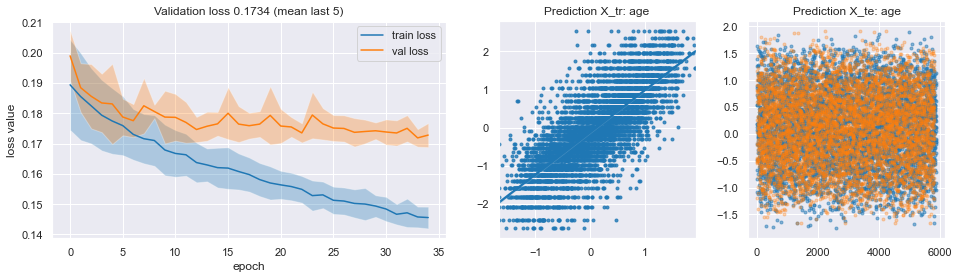

0.146709 0.173392 0.026682999999999985
0002/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


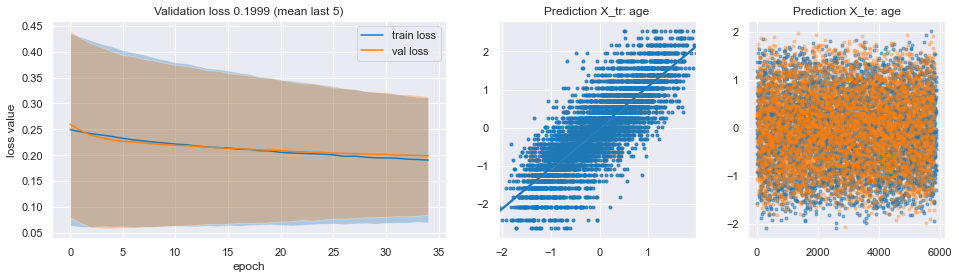

0.192531 0.199867 0.007335999999999981
0003/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


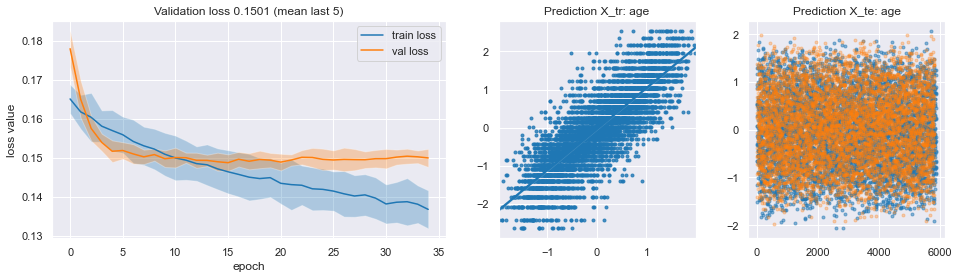

0.138014 0.150057 0.012042999999999998
0004/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


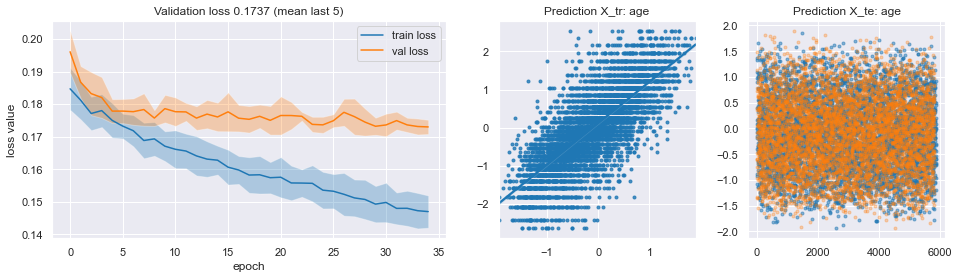

0.147999 0.173651 0.025652000000000008
0005/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


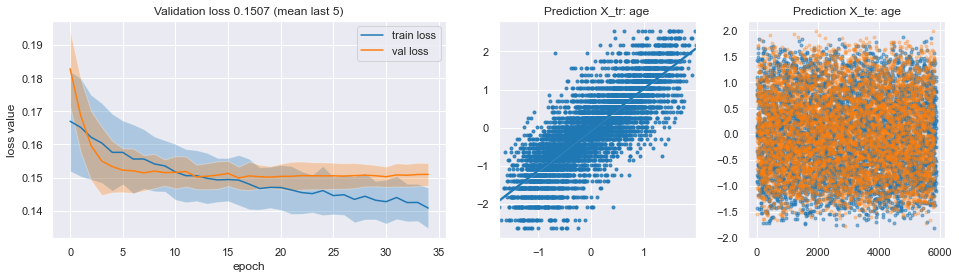

0.142472 0.150712 0.008240000000000025
0006/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


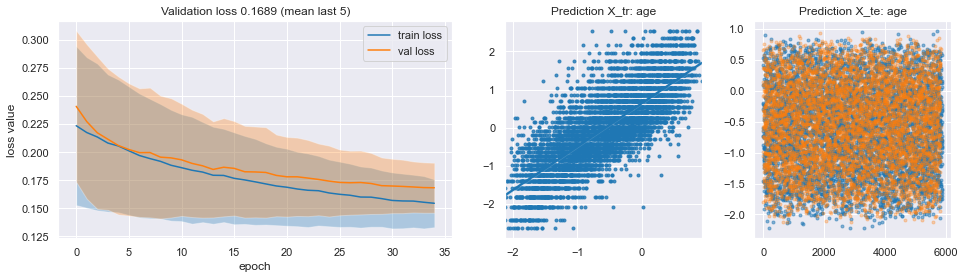

0.155864 0.168932 0.013067999999999996
0007/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


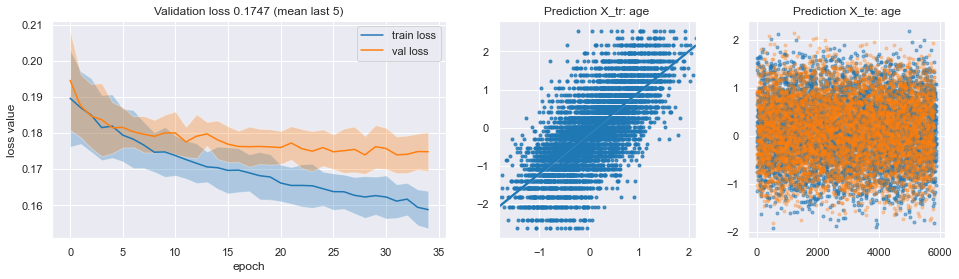

0.160639 0.174663 0.014024000000000009
0008/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


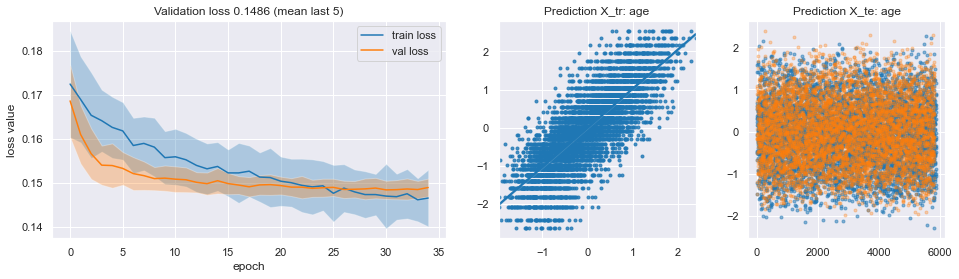

0.146853 0.148611 0.0017579999999999818
0009/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


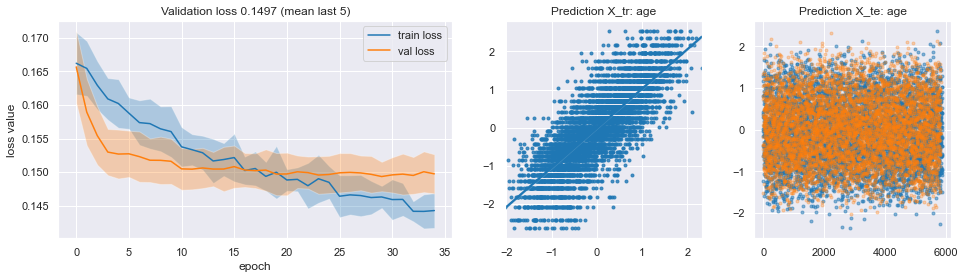

0.144881 0.149712 0.004831000000000002
0010/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


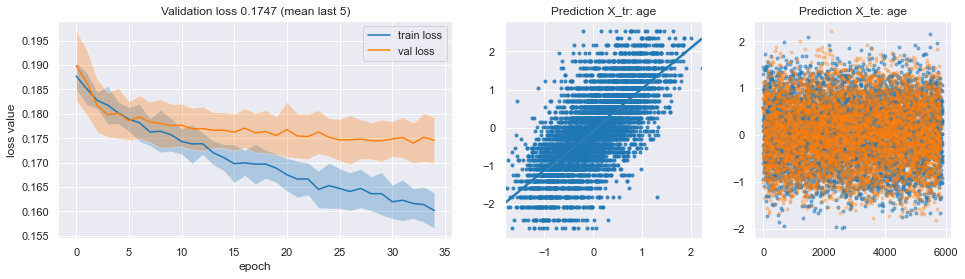

0.16148 0.174738 0.013257999999999992
0011/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


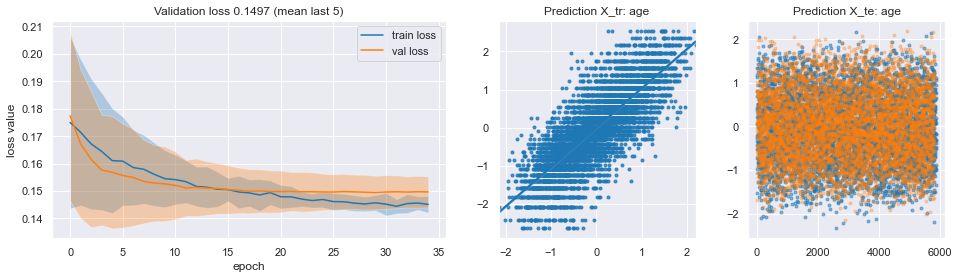

0.145179 0.149699 0.004519999999999996
0012/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


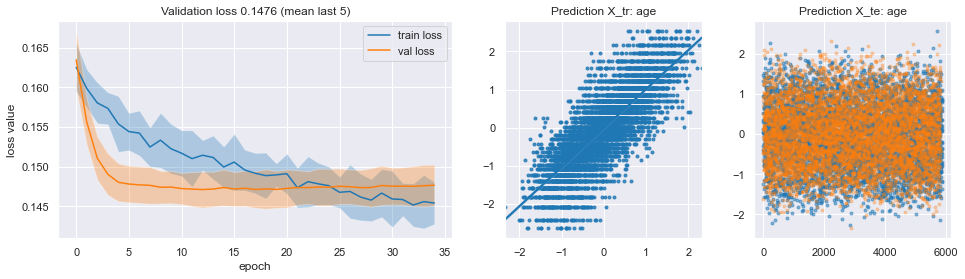

0.14557 0.147556 0.0019859999999999878
0013/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


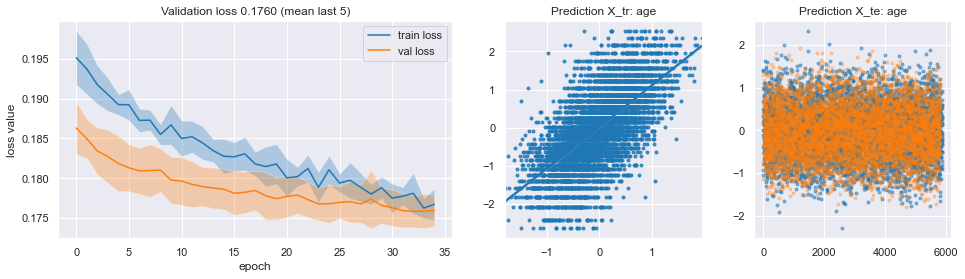

0.177266 0.175982 -0.0012840000000000074
0014/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


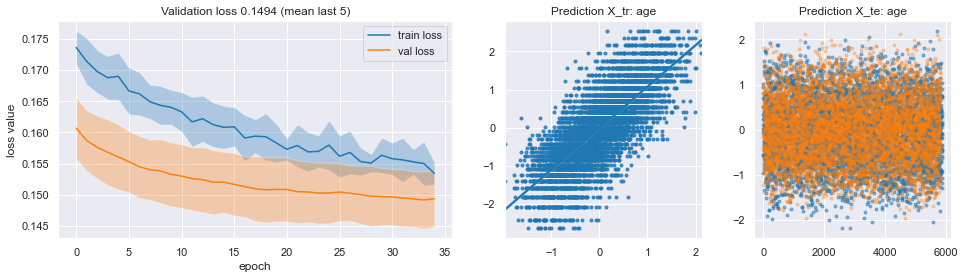

0.155025 0.149404 -0.005620999999999987
0015/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


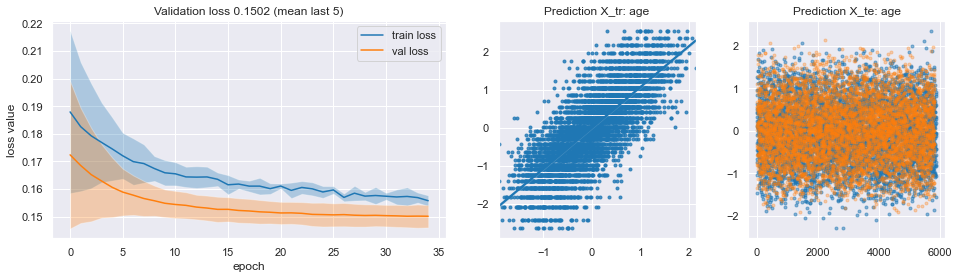

0.156874 0.150198 -0.006676000000000015
0016/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


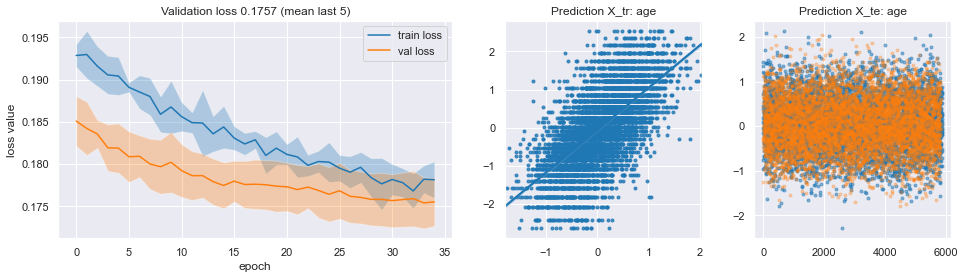

0.177834 0.175666 -0.0021680000000000033
0017/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


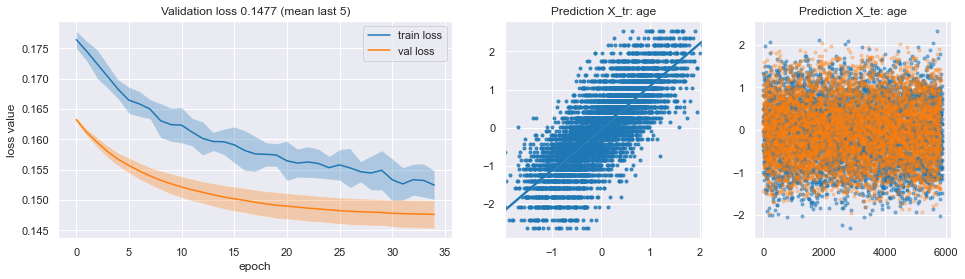

0.152998 0.147709 -0.005288999999999988
0018/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


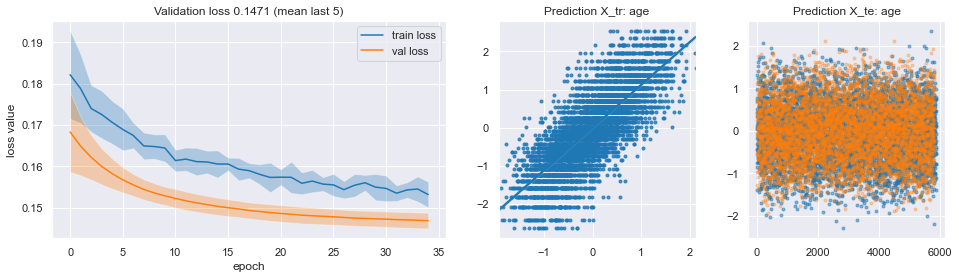

0.154052 0.147073 -0.006978999999999985



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
17,0.154052,0.147073,64,40,sigmoid,0.2,"(64,)",869,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),PowerTransformer()
11,0.145570,0.147556,64,40,sigmoid,0.2,"(128, 32)",869,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),PowerTransformer()
16,0.152998,0.147709,64,40,sigmoid,0.2,"(64,)",853,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()
7,0.146853,0.148611,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,0,True,True,None,RobustScaler()
13,0.155025,0.149404,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,0,True,True,None,RobustScaler()
10,0.145179,0.149699,64,40,sigmoid,0.2,"(128, 32)",853,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()
8,0.144881,0.149712,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,0,True,True,None,PowerTransformer()
2,0.138014,0.150057,64,40,sigmoid,0.2,"(256, 64, 16)",1404,uniform,1,adagrad,0,True,True,None,PowerTransformer()
14,0.156874,0.150198,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,0,True,True,None,PowerTransformer()
4,0.142472,0.150712,64,40,sigmoid,0.2,"(256, 64, 16)",853,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()


Starting with dataset merge - target: domain1_var1
Removing 435 missing values from target dataset.
Size of dataset:  (5390, 1404)
18 grid points will be checked!

---Start_Grid_Exploration---



0001/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


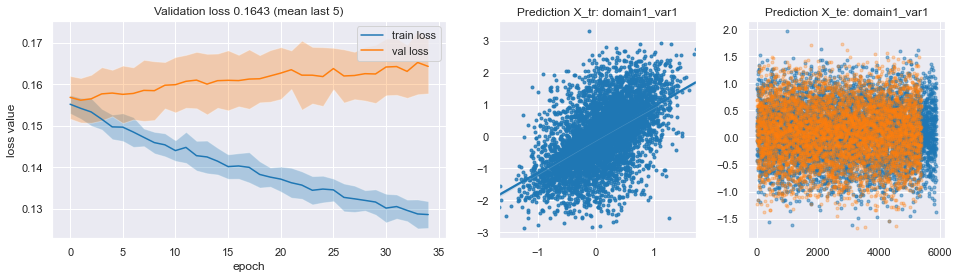

0.12959 0.164252 0.034662
0002/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


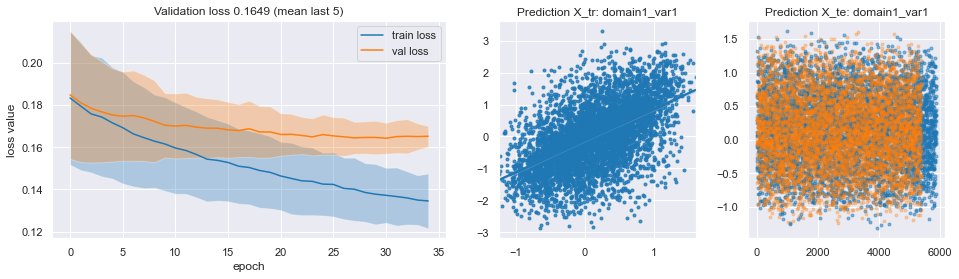

0.135894 0.164906 0.02901200000000001
0003/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


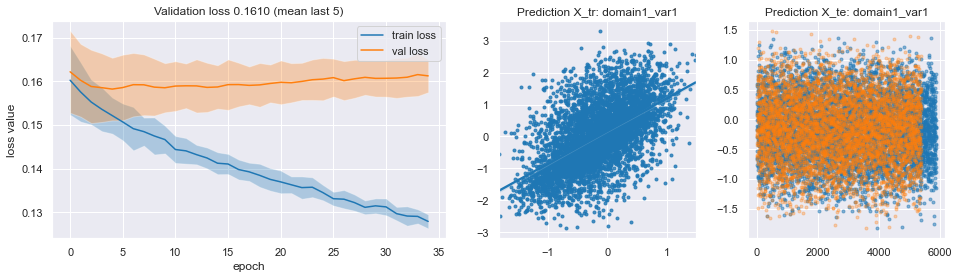

0.129423 0.161034 0.031611
0004/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


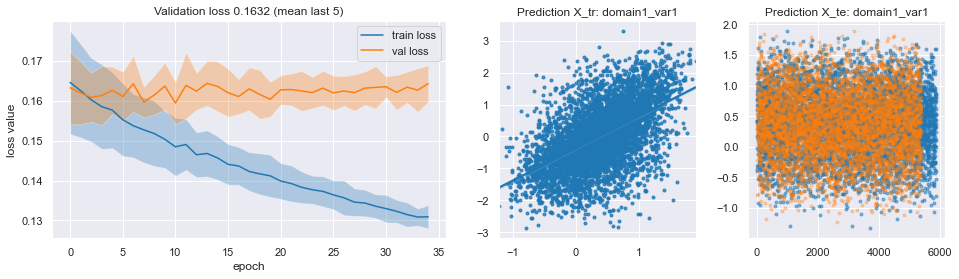

0.131698 0.163162 0.03146399999999999
0005/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


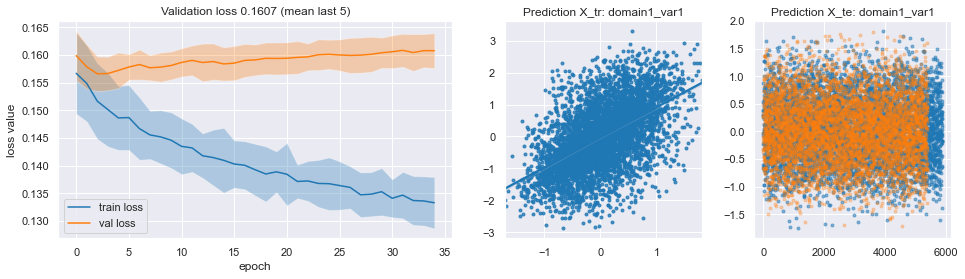

0.133871 0.160709 0.026838
0006/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


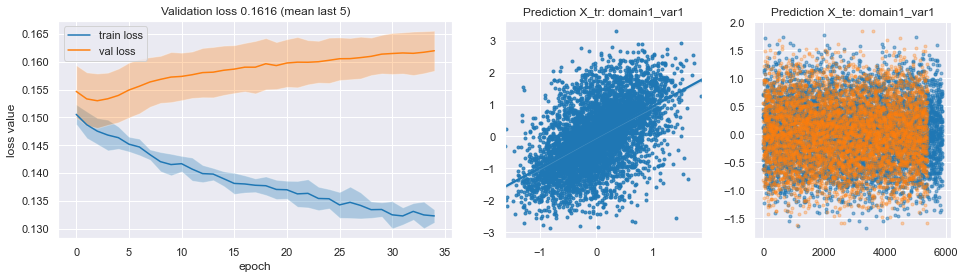

0.132542 0.161642 0.029100000000000015
0007/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


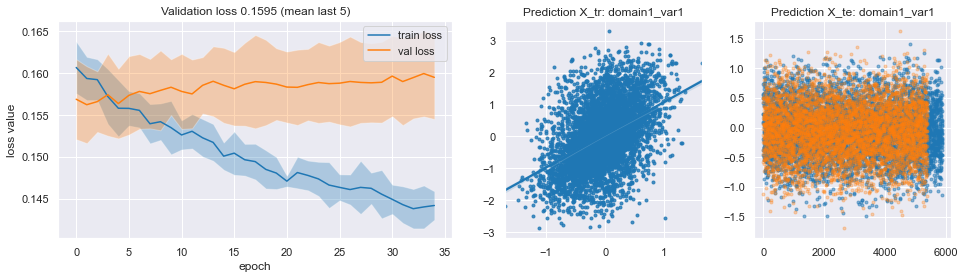

0.144274 0.159535 0.015260999999999997
0008/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


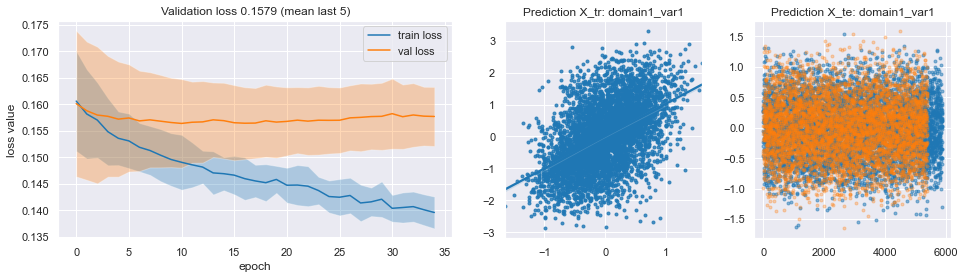

0.140248 0.15788 0.01763199999999998
0009/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


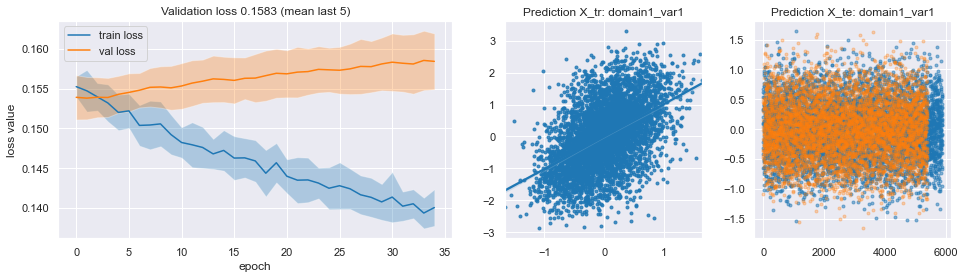

0.140312 0.158302 0.017990000000000006
0010/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


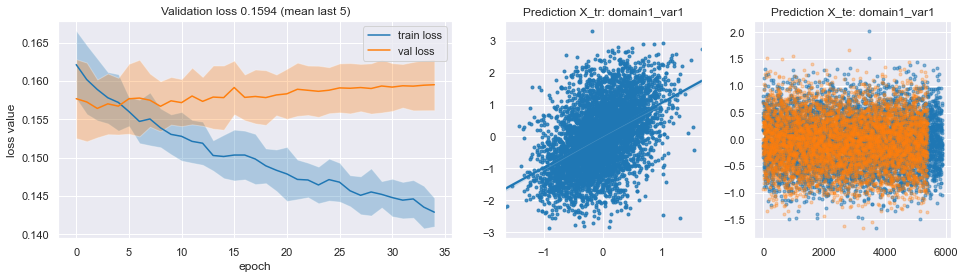

0.144045 0.159382 0.01533699999999999
0011/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


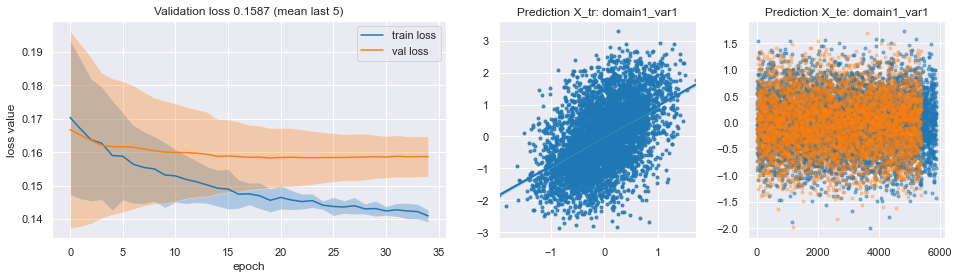

0.142129 0.15867 0.016541
0012/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


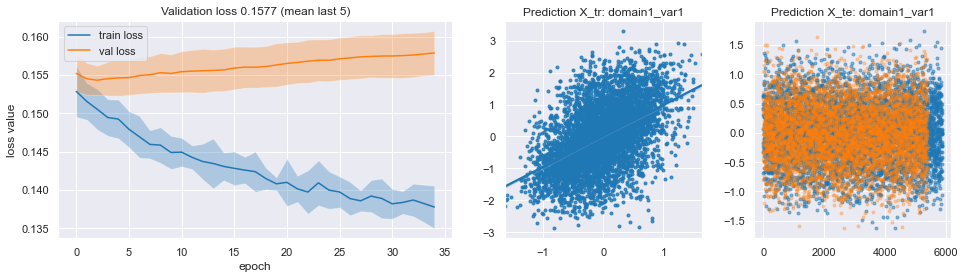

0.138272 0.157654 0.019381999999999983
0013/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


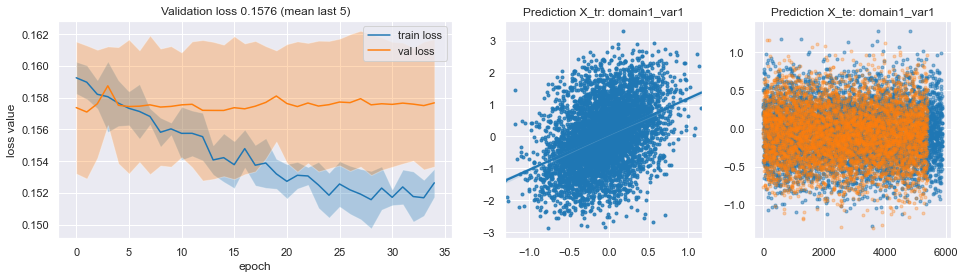

0.152047 0.157603 0.005556000000000005
0014/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


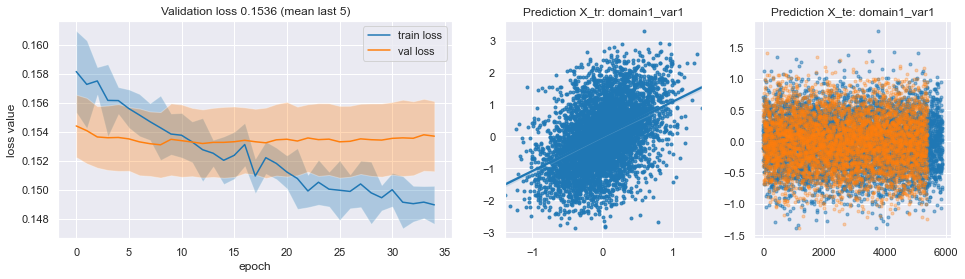

0.149261 0.153641 0.004379999999999995
0015/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


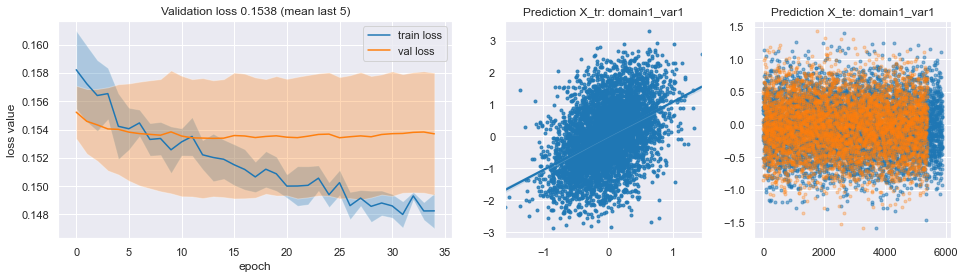

0.14848 0.153756 0.005276000000000003
0016/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


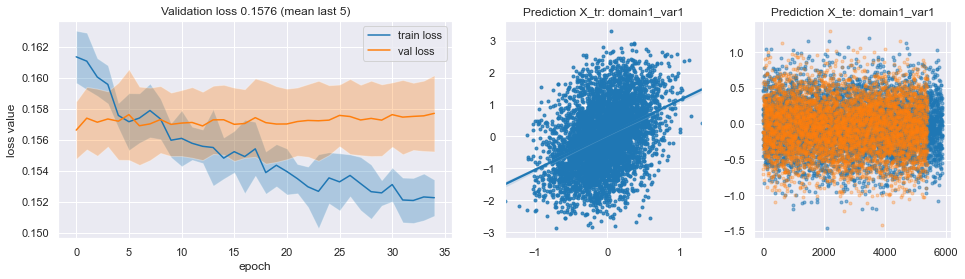

0.15239 0.157566 0.005176000000000014
0017/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


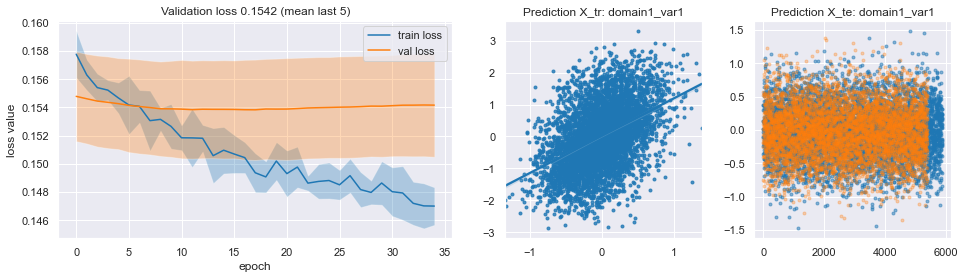

0.147433 0.154159 0.006725999999999982
0018/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


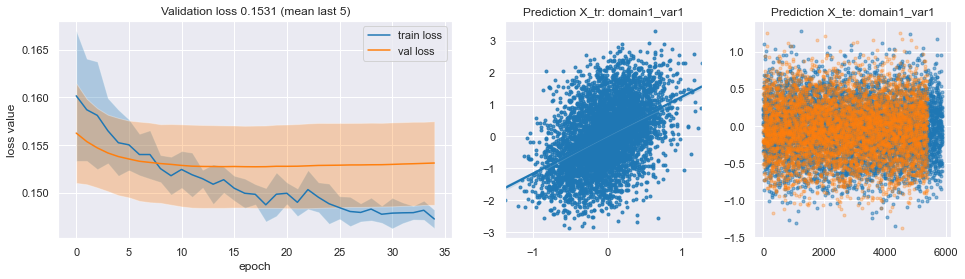

0.147841 0.153064 0.005223000000000005



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
17,0.147841,0.153064,64,40,sigmoid,0.2,"(64,)",864,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()
13,0.149261,0.153641,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,1,True,True,None,RobustScaler()
14,0.148480,0.153756,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,1,True,True,None,PowerTransformer()
16,0.147433,0.154159,64,40,sigmoid,0.2,"(64,)",848,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),RobustScaler()
15,0.152390,0.157566,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),None
12,0.152047,0.157603,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,1,True,True,None,None
11,0.138272,0.157654,64,40,sigmoid,0.2,"(128, 32)",864,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()
7,0.140248,0.157880,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,1,True,True,None,RobustScaler()
8,0.140312,0.158302,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,1,True,True,None,PowerTransformer()
10,0.142129,0.158670,64,40,sigmoid,0.2,"(128, 32)",848,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),RobustScaler()


Starting with dataset merge - target: domain1_var2
Removing 435 missing values from target dataset.
Size of dataset:  (5390, 1404)
18 grid points will be checked!

---Start_Grid_Exploration---



0001/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


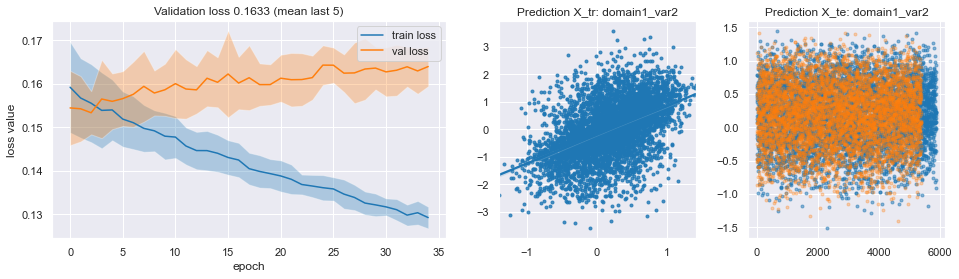

0.130401 0.163326 0.03292500000000001
0002/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


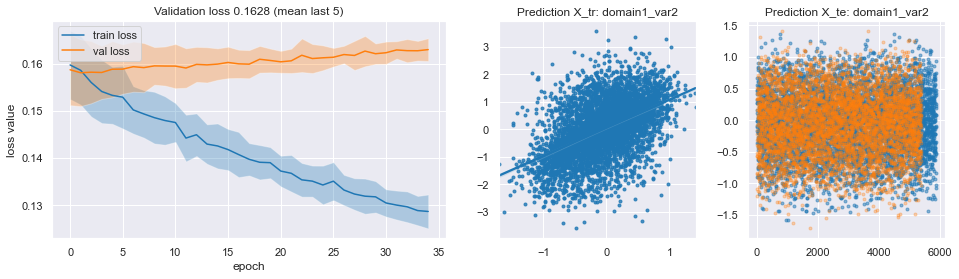

0.129524 0.162756 0.03323200000000001
0003/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


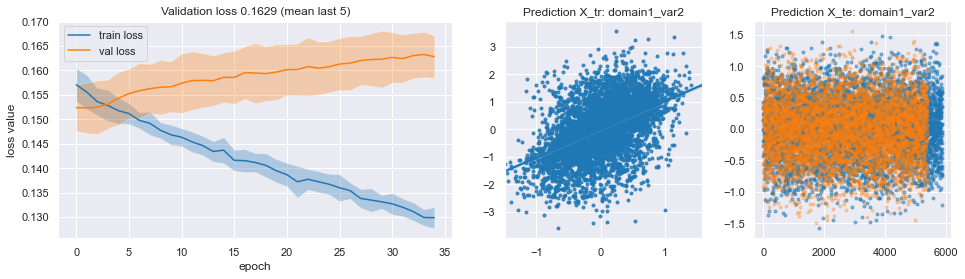

0.13113 0.162857 0.031727000000000005
0004/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


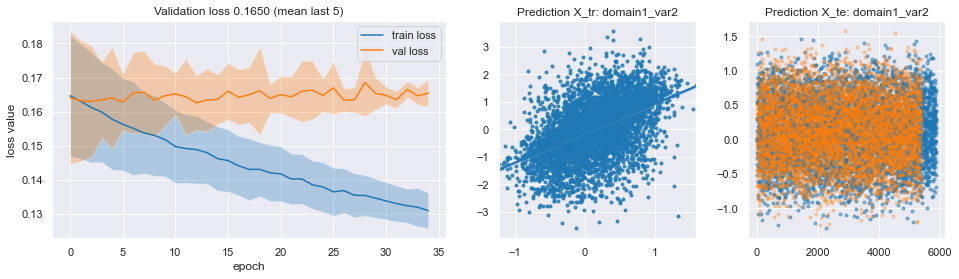

0.132439 0.164976 0.03253700000000001
0005/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


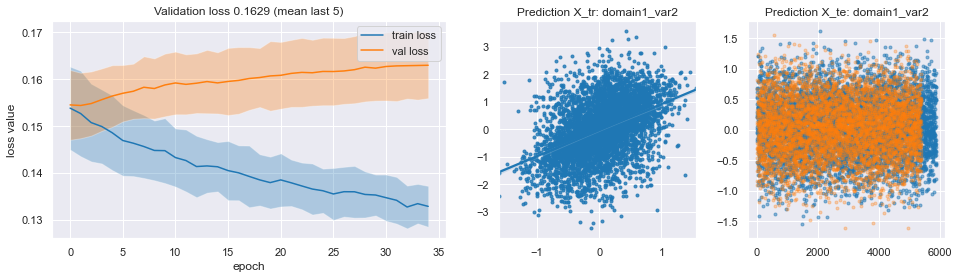

0.133616 0.16288 0.029263999999999984
0006/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


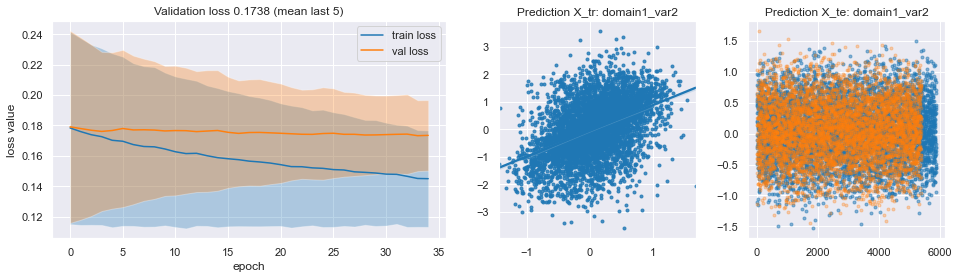

0.146487 0.173813 0.02732599999999999
0007/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


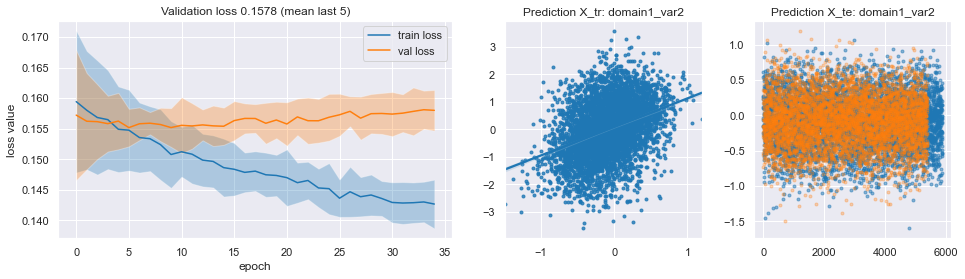

0.14286 0.157764 0.014904
0008/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


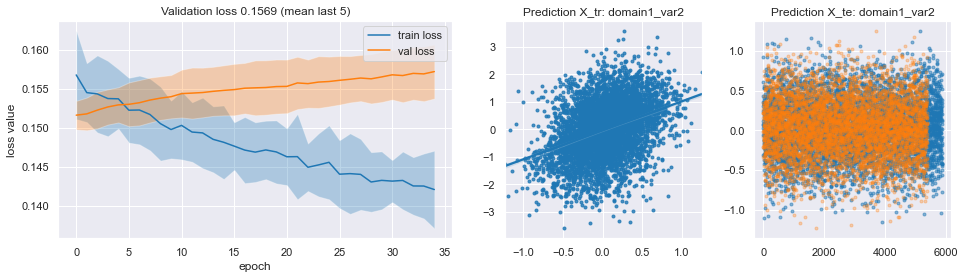

0.142708 0.156903 0.014194999999999985
0009/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


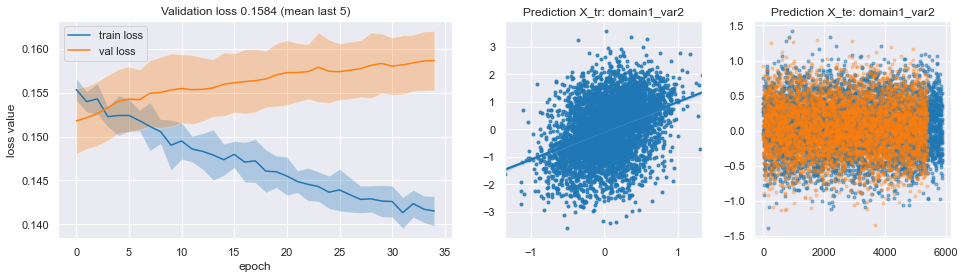

0.141906 0.15837 0.016464000000000006
0010/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


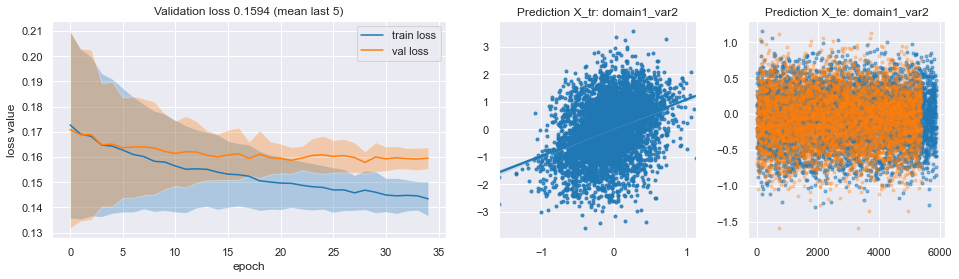

0.144431 0.159403 0.014971999999999985
0011/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


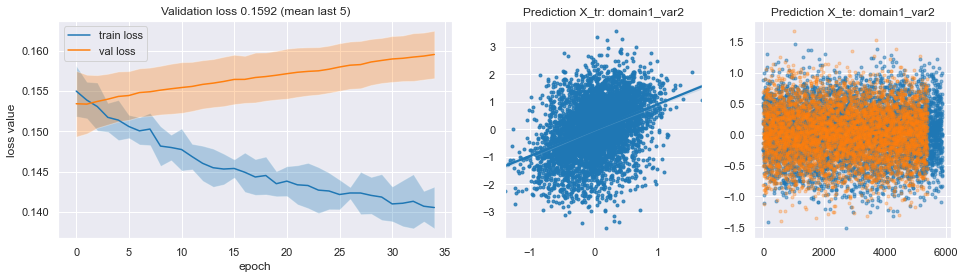

0.140929 0.159207 0.01827799999999999
0012/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


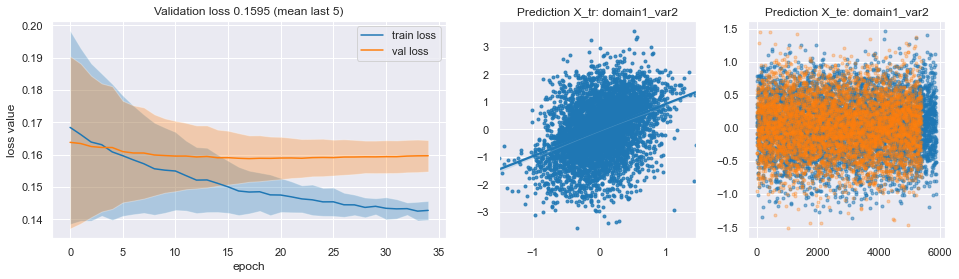

0.142989 0.159484 0.016494999999999982
0013/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


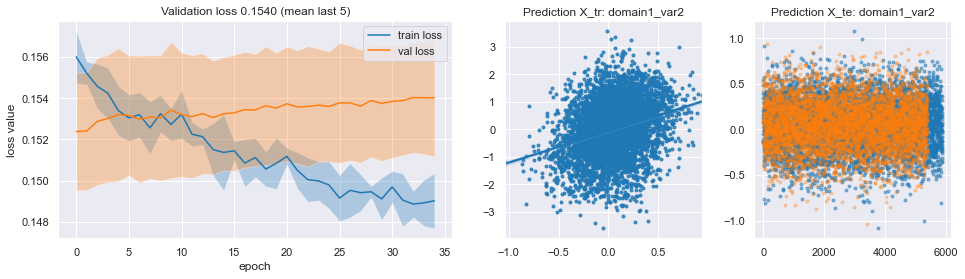

0.149109 0.153959 0.004850000000000021
0014/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


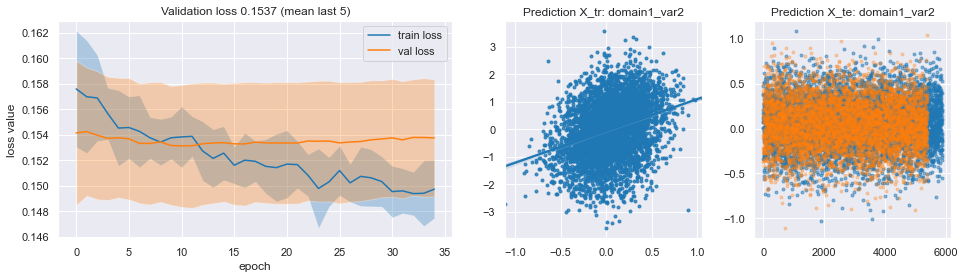

0.149529 0.153734 0.004205000000000014
0015/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


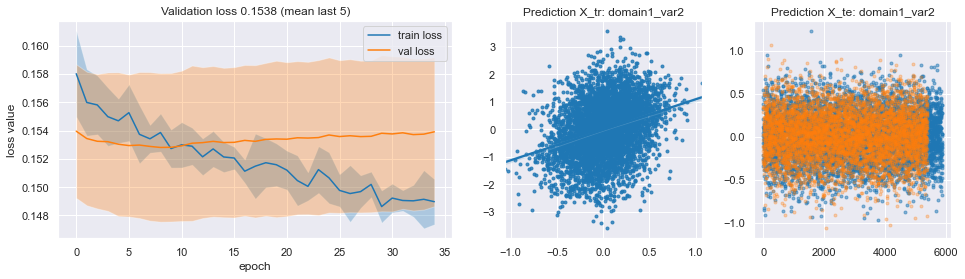

0.149085 0.153792 0.004707000000000017
0016/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


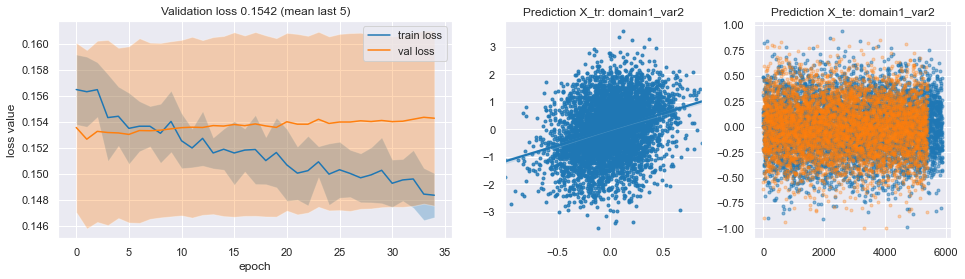

0.149032 0.154171 0.005139000000000005
0017/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


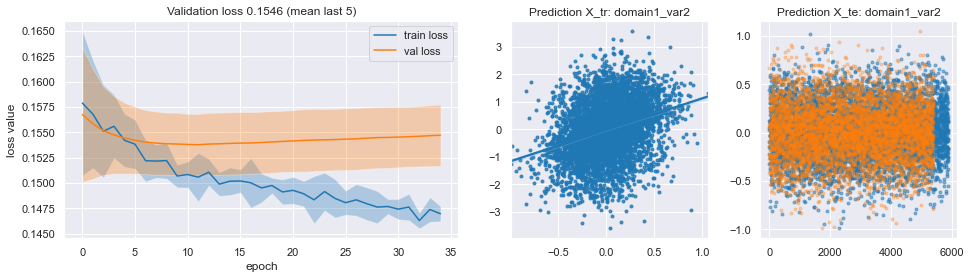

0.147132 0.154607 0.007474999999999982
0018/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


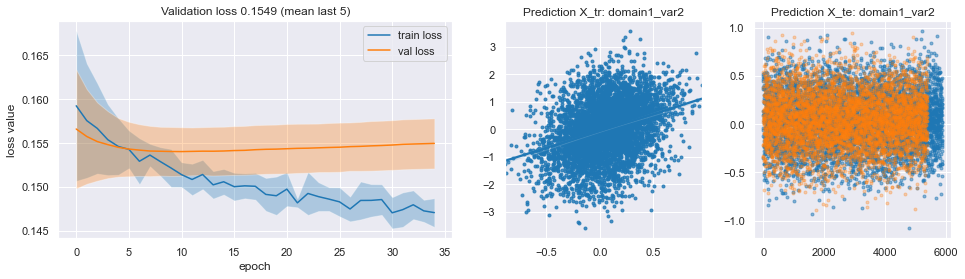

0.147373 0.154898 0.007525000000000004



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
13,0.149529,0.153734,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,2,True,True,None,RobustScaler()
14,0.149085,0.153792,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,2,True,True,None,PowerTransformer()
12,0.149109,0.153959,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,2,True,True,None,None
15,0.149032,0.154171,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),None
16,0.147132,0.154607,64,40,sigmoid,0.2,"(64,)",848,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),RobustScaler()
17,0.147373,0.154898,64,40,sigmoid,0.2,"(64,)",864,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),PowerTransformer()
7,0.142708,0.156903,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,2,True,True,None,RobustScaler()
6,0.142860,0.157764,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,2,True,True,None,None
8,0.141906,0.158370,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,2,True,True,None,PowerTransformer()
10,0.140929,0.159207,64,40,sigmoid,0.2,"(128, 32)",848,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),RobustScaler()


Starting with dataset merge - target: domain2_var1
Removing 39 missing values from target dataset.
Size of dataset:  (5786, 1404)
18 grid points will be checked!

---Start_Grid_Exploration---



0001/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


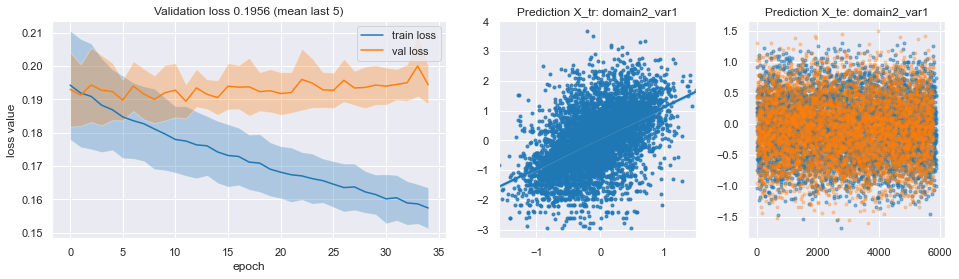

0.159096 0.195558 0.03646200000000002
0002/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


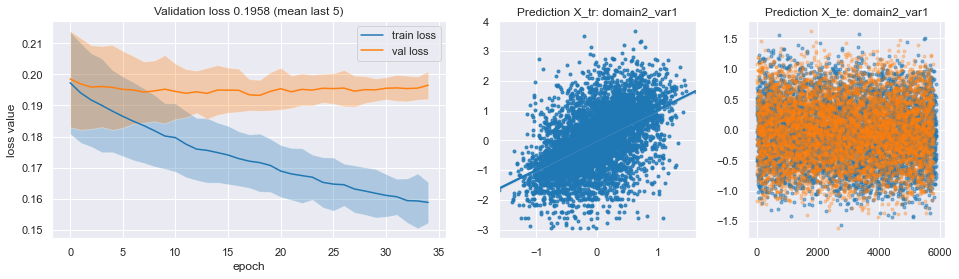

0.159838 0.19575 0.035912
0003/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


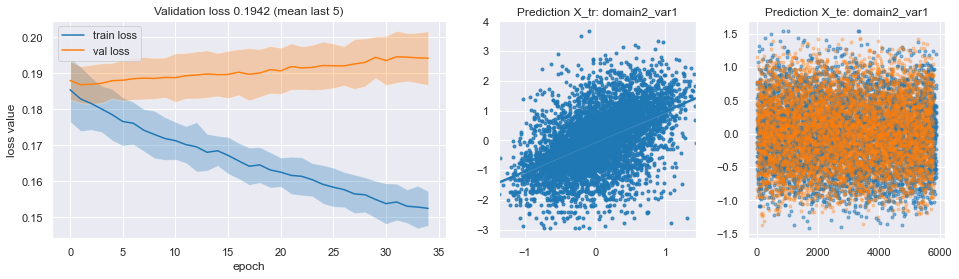

0.153312 0.194214 0.040901999999999994
0004/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


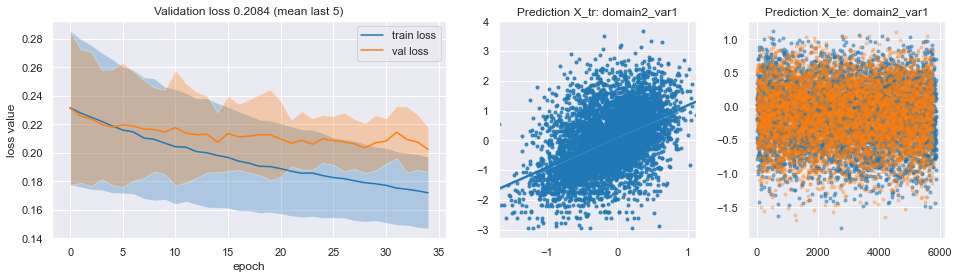

0.174416 0.208402 0.033986000000000016
0005/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


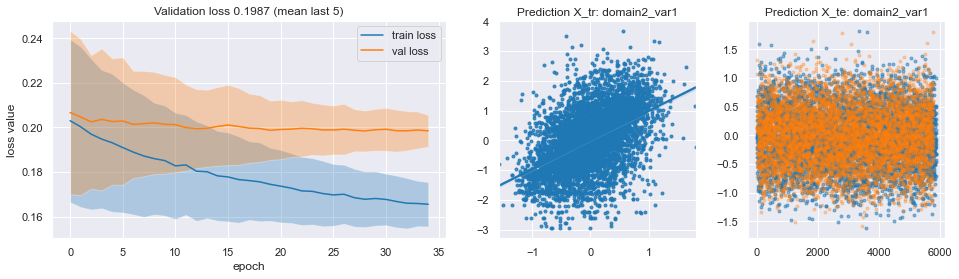

0.166376 0.198684 0.032308
0006/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


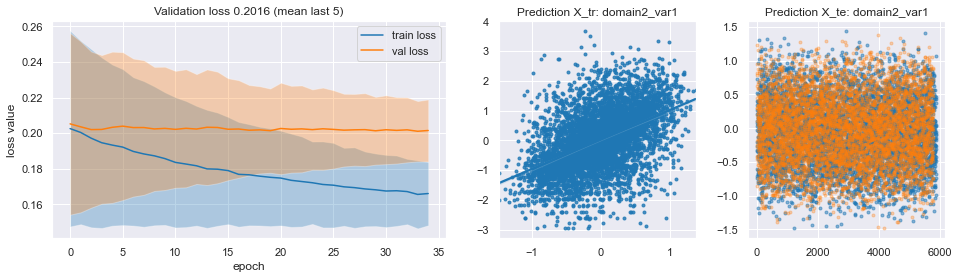

0.16678 0.201559 0.03477899999999998
0007/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


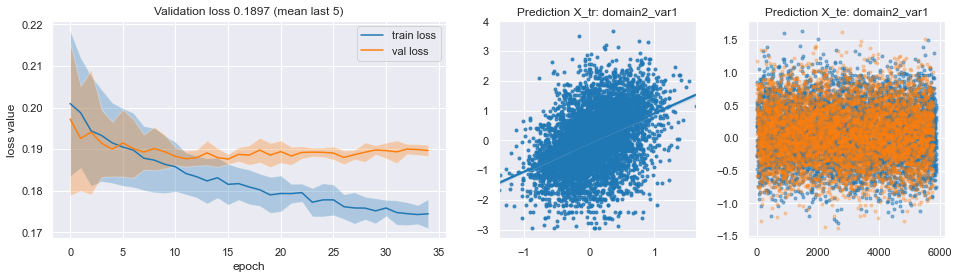

0.174755 0.189711 0.014955999999999997
0008/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


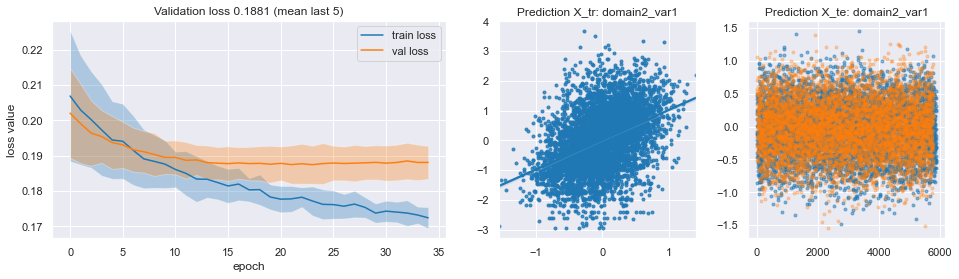

0.173486 0.188078 0.014591999999999994
0009/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


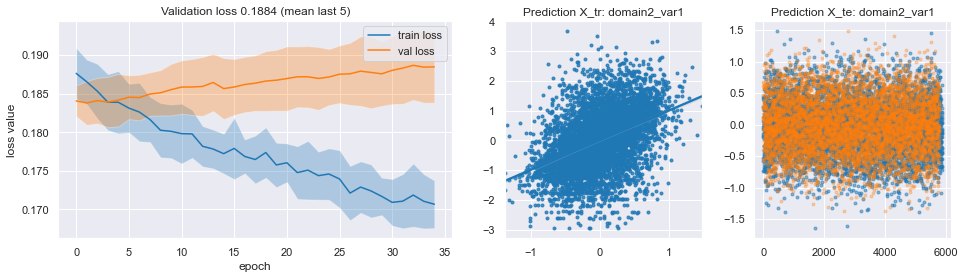

0.171101 0.188387 0.017285999999999996
0010/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


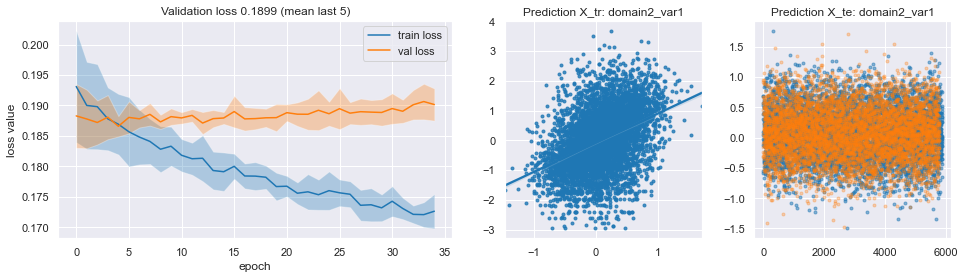

0.172862 0.189894 0.01703200000000002
0011/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


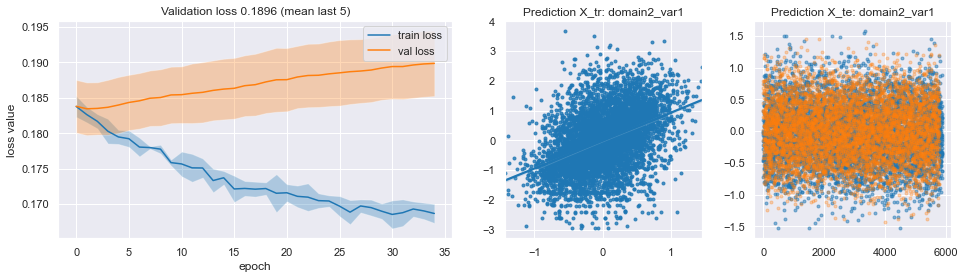

0.168842 0.189627 0.020784999999999998
0012/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


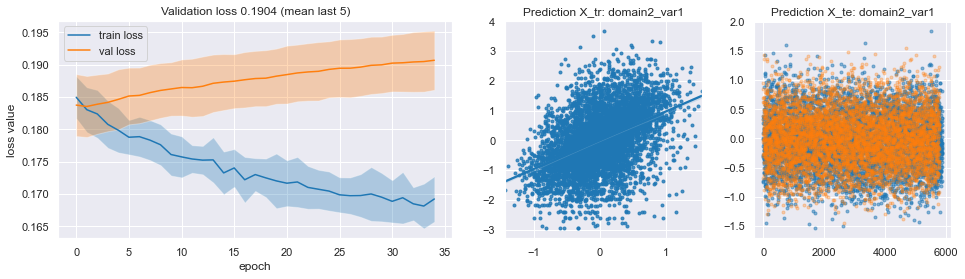

0.168807 0.190432 0.021624999999999978
0013/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


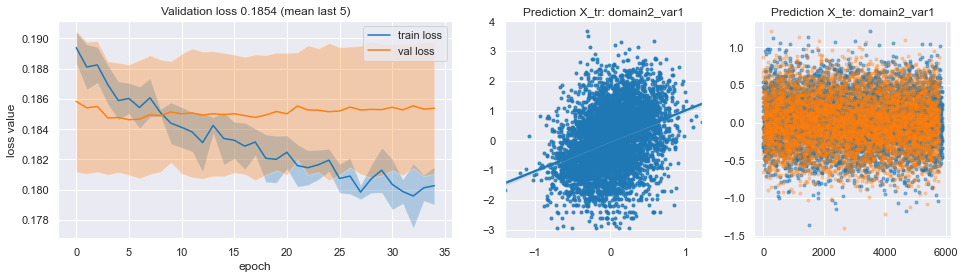

0.180037 0.185395 0.005358000000000002
0014/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


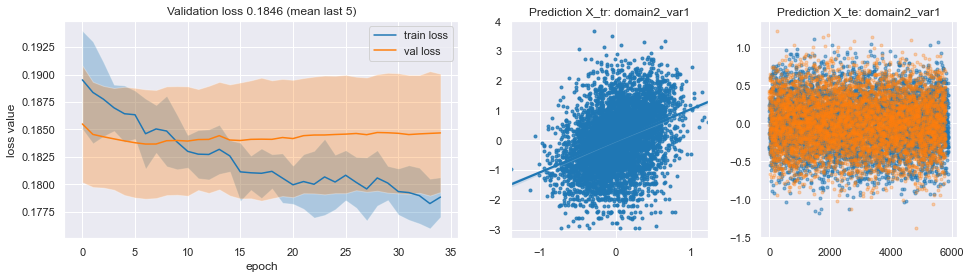

0.178931 0.184618 0.005686999999999998
0015/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


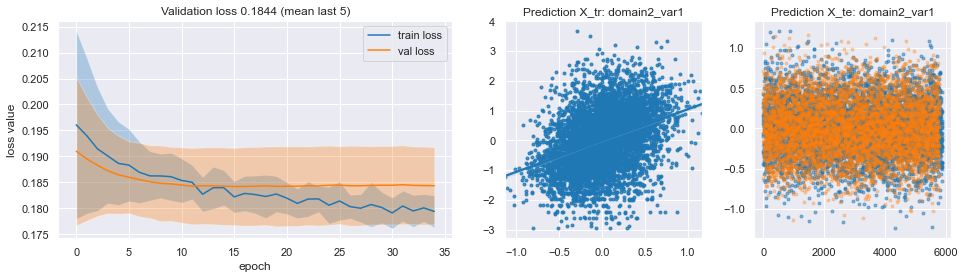

0.179709 0.184428 0.004719000000000001
0016/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


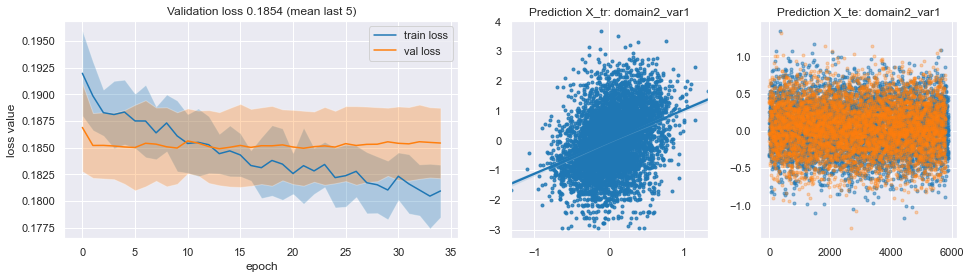

0.181264 0.185442 0.004177999999999987
0017/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


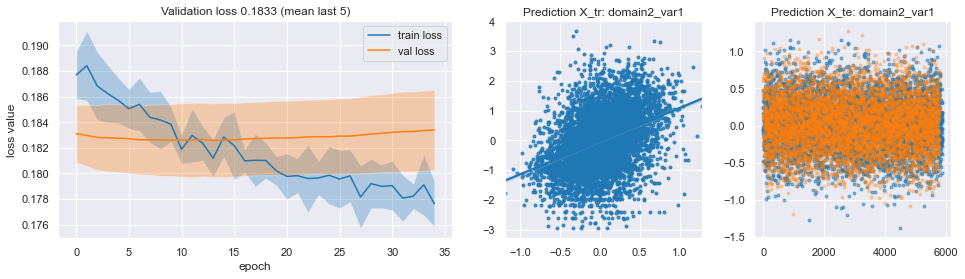

0.178415 0.183296 0.0048809999999999965
0018/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


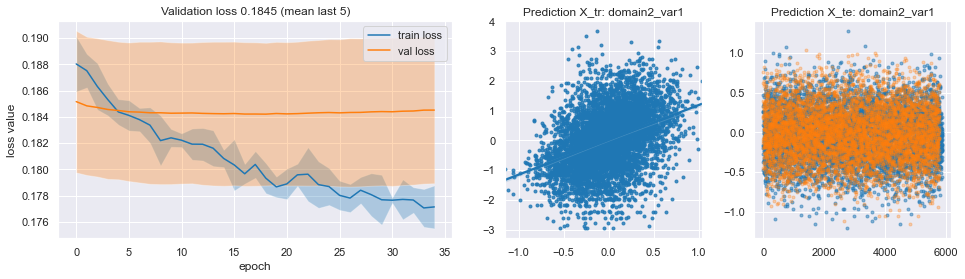

0.177454 0.184454 0.007000000000000006



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
16,0.178415,0.183296,64,40,sigmoid,0.2,"(64,)",853,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),RobustScaler()
14,0.179709,0.184428,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,3,True,True,None,PowerTransformer()
17,0.177454,0.184454,64,40,sigmoid,0.2,"(64,)",869,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),PowerTransformer()
13,0.178931,0.184618,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,3,True,True,None,RobustScaler()
12,0.180037,0.185395,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,3,True,True,None,None
15,0.181264,0.185442,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),None
7,0.173486,0.188078,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,3,True,True,None,RobustScaler()
8,0.171101,0.188387,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,3,True,True,None,PowerTransformer()
10,0.168842,0.189627,64,40,sigmoid,0.2,"(128, 32)",853,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),RobustScaler()
6,0.174755,0.189711,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,3,True,True,None,None


Starting with dataset merge - target: domain2_var2
Removing 39 missing values from target dataset.
Size of dataset:  (5786, 1404)
18 grid points will be checked!

---Start_Grid_Exploration---



0001/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


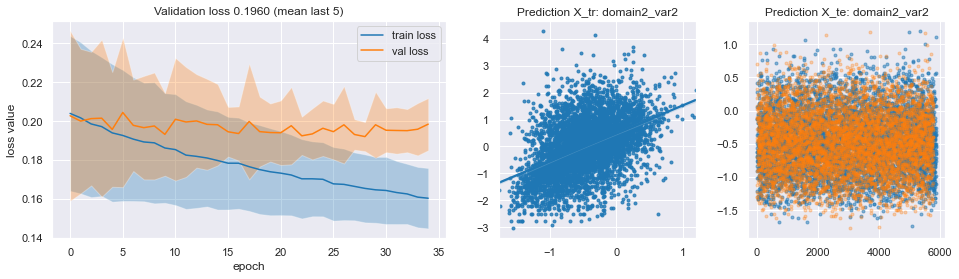

0.162268 0.195969 0.03370100000000001
0002/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


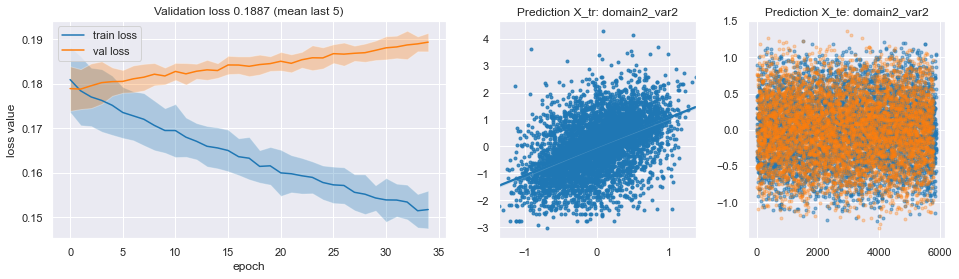

0.152872 0.188668 0.035795999999999994
0003/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


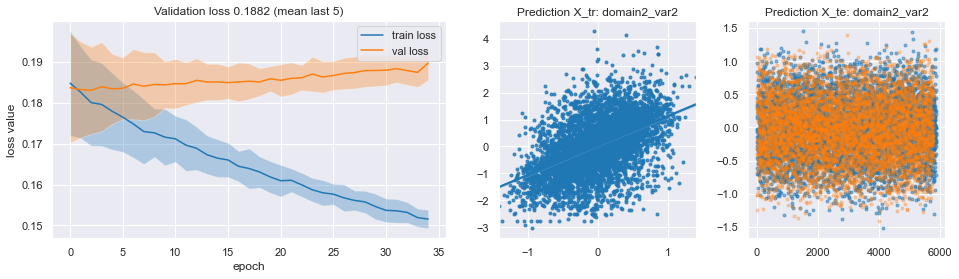

0.152792 0.188222 0.03542999999999999
0004/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


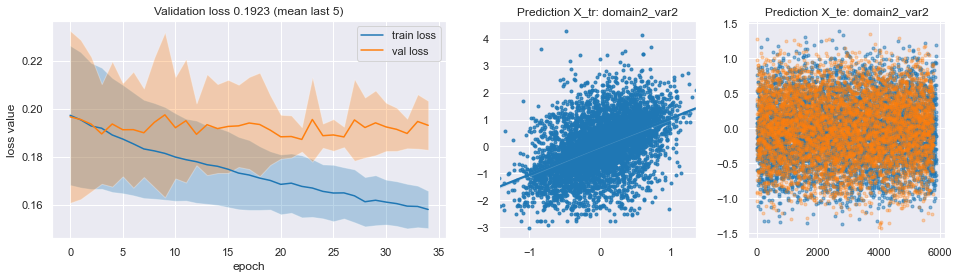

0.159775 0.192339 0.03256400000000001
0005/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


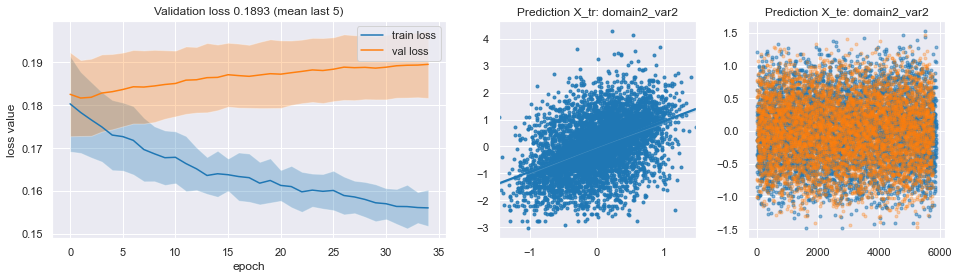

0.156412 0.189251 0.03283900000000001
0006/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (256, 64, 16), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


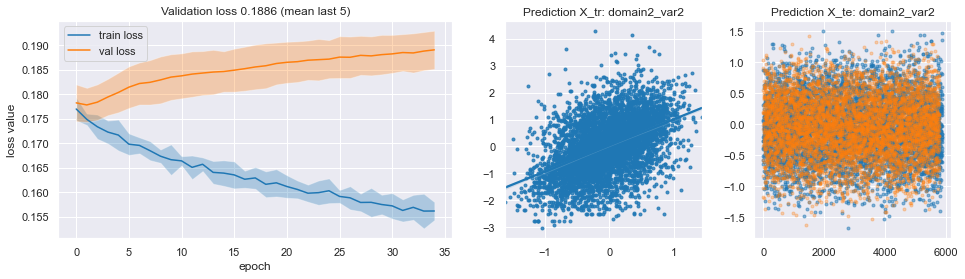

0.15658 0.188607 0.032027
0007/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


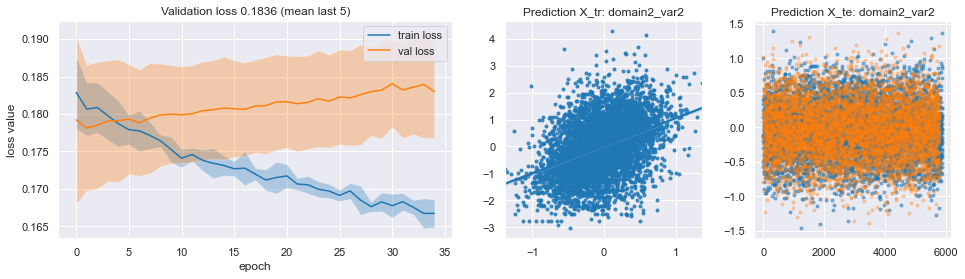

0.167418 0.183552 0.01613399999999998
0008/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


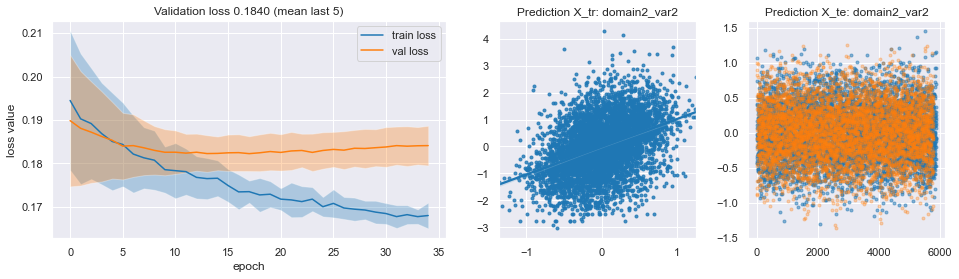

0.168056 0.184014 0.015958
0009/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


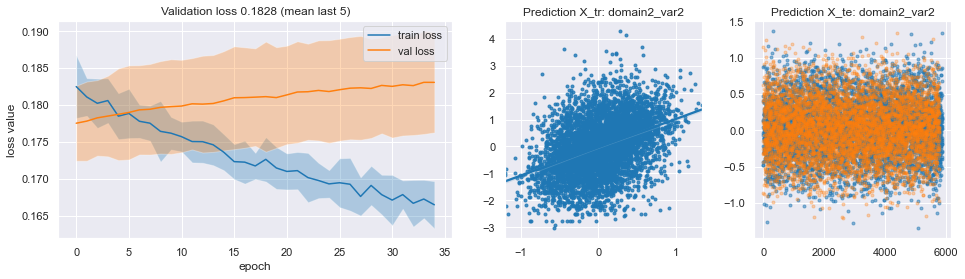

0.167102 0.182808 0.015705999999999998
0010/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


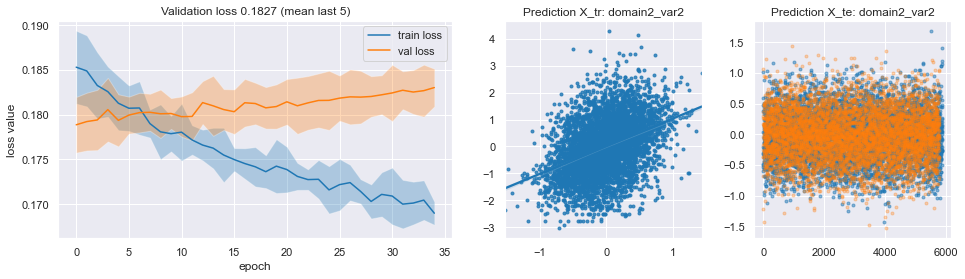

0.170093 0.182691 0.012597999999999998
0011/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


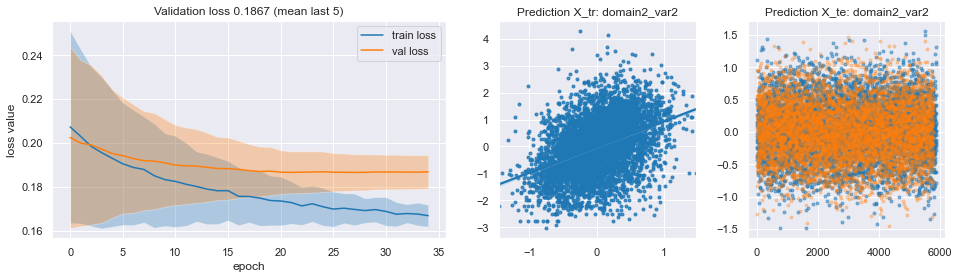

0.167697 0.186748 0.019050999999999985
0012/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


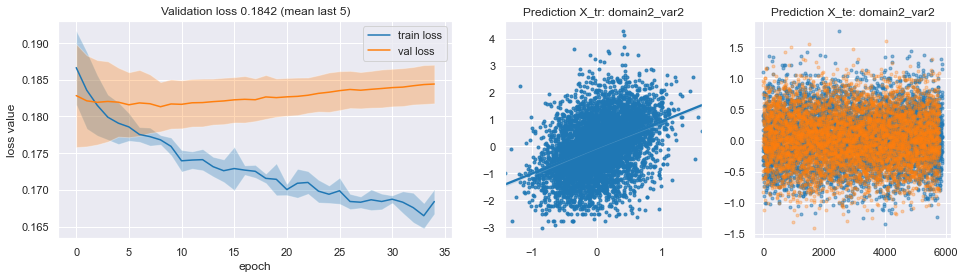

0.167898 0.184182 0.01628400000000002
0013/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': None}


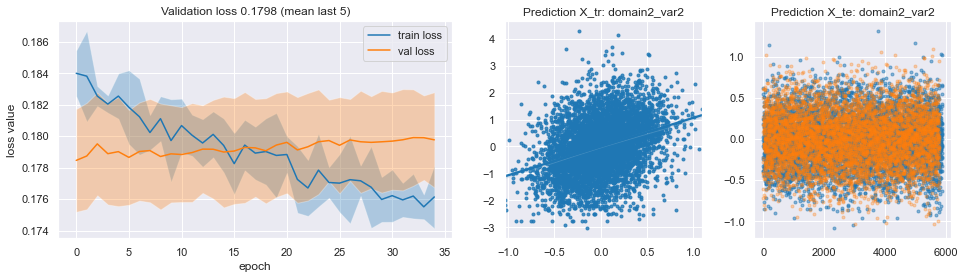

0.176001 0.179803 0.003802
0014/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


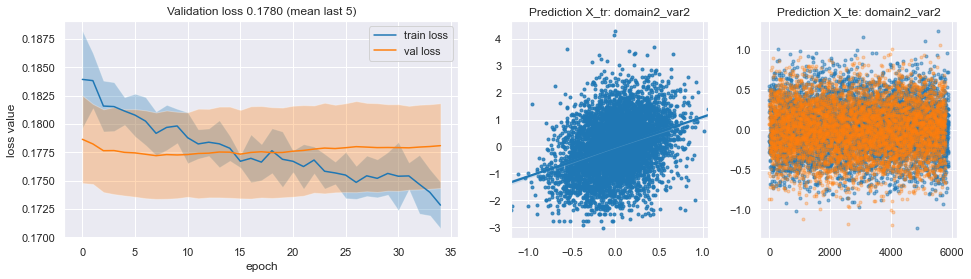

0.174456 0.177969 0.0035129999999999884
0015/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


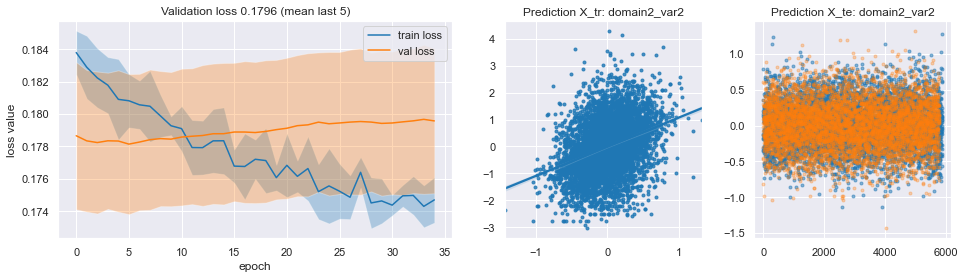

0.174664 0.179559 0.004894999999999983
0016/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': None}


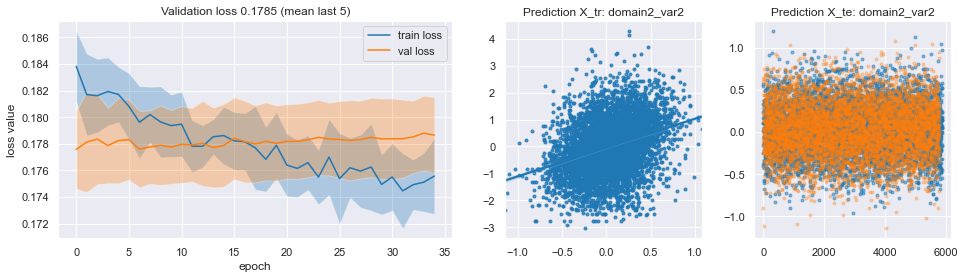

0.175112 0.178544 0.0034320000000000184
0017/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


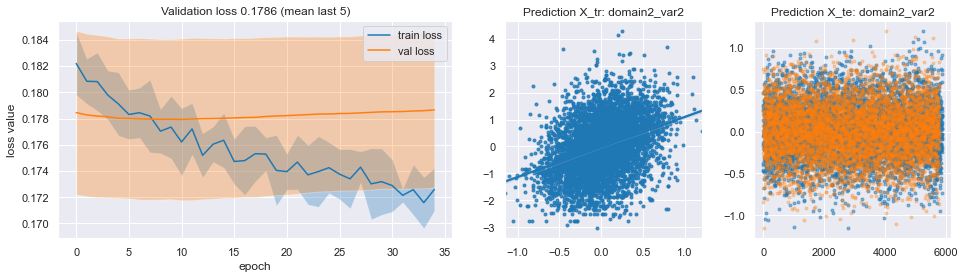

0.172359 0.178579 0.0062199999999999755
0018/0018 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1404, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


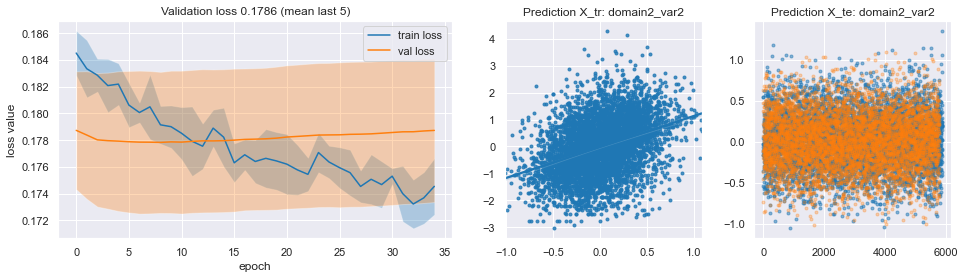

0.174146 0.178649 0.004503000000000007



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
13,0.174456,0.177969,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,4,True,True,None,RobustScaler()
15,0.175112,0.178544,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),None
16,0.172359,0.178579,64,40,sigmoid,0.2,"(64,)",853,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),RobustScaler()
17,0.174146,0.178649,64,40,sigmoid,0.2,"(64,)",869,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),PowerTransformer()
14,0.174664,0.179559,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,4,True,True,None,PowerTransformer()
12,0.176001,0.179803,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,4,True,True,None,None
9,0.170093,0.182691,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),None
8,0.167102,0.182808,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,4,True,True,None,PowerTransformer()
6,0.167418,0.183552,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,4,True,True,None,None
7,0.168056,0.184014,64,40,sigmoid,0.2,"(128, 32)",1404,uniform,1,adagrad,4,True,True,None,RobustScaler()


,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
0,0.154052,0.147073,64,40,sigmoid,0.2,"(64,)",869,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),PowerTransformer()
1,0.147841,0.153064,64,40,sigmoid,0.2,"(64,)",864,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()
2,0.149529,0.153734,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,2,True,True,None,RobustScaler()
3,0.178415,0.183296,64,40,sigmoid,0.2,"(64,)",853,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),RobustScaler()
4,0.174456,0.177969,64,40,sigmoid,0.2,"(64,)",1404,uniform,1,adagrad,4,True,True,None,RobustScaler()


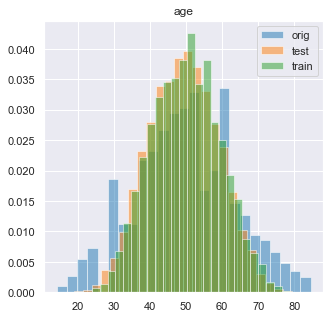

/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


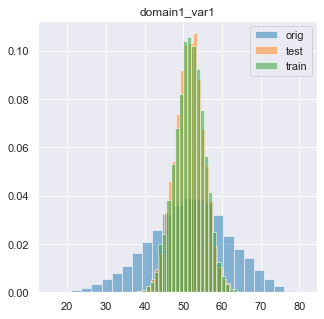

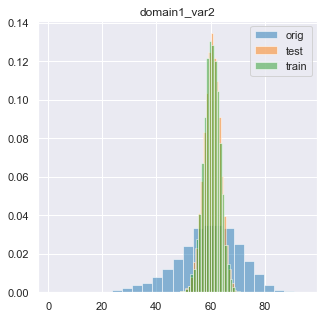

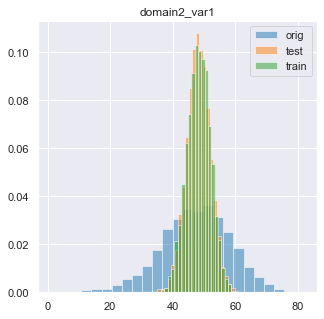

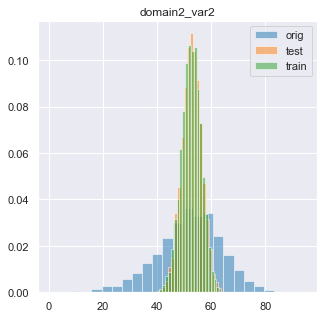

Score: 0.1610 | 0.1471 0.1531 0.1537 0.1833 0.1780


In [21]:
datasets_to_check = ['merge']

for dataset_id in datasets_to_check:

    predictions = {}
    scores = []
    grids = []
    
    for tidx, target in enumerate(['age', 'domain1_var1', 'domain1_var2', 'domain2_var1', 'domain2_var2']):

        print('Starting with dataset %s - target: %s' % (dataset_id, target))
        pred_tr, pred_te, top_grid, idx, df_grid = run_prediction(
            targets, dataset_id=dataset_id, target=target, tidx=tidx)
        
        predictions['%s_tr' % target] = pred_tr
        predictions['%s_te' % target] = pred_te
        predictions['%s_miss' % target] = idx
        
        scores.append(top_grid['te_mean'])
        grids.append(top_grid)

    # Display grids summary
    grid_summary = pd.concat([pd.DataFrame(g).T for g in grids]).reset_index().drop(columns='index')
    display(grid_summary)
    
    # Compute overall score
    weights = [.3, .175, .175, .175, .175]
    score = np.sum([s * weights[i] for i, s in enumerate(scores)])
    score_postfix = [int(score*10000)] + [int(s*10000) for i, s in enumerate(scores)]

    df_results_tr, df_results_te = save_results(
        predictions, scaler_targets, targets, test_id, feature_transform,
        sample_submission, dataset_id, score_postfix)

    plot_prediction_distributions(targets, scaler_targets, df_results_tr, df_results_te)
    
    # Feedback of overall score
    txt = 'Score: {:.4f} | {:.4f} {:.4f} {:.4f} {:.4f} {:.4f}'.format(score, *scores)
    print(txt)

In [22]:
def create_grid(input_size=100, num_targets=1, tidx=0):

    # Define parameter grid
    param_grid = [
    { 
        'scaler': [RobustScaler(),
                   PowerTransformer()
                   ],
        'pca': [None, PCA(0.99)],
        'nn__input_size': [input_size],
        'nn__optimizer': ['adagrad'], #['rmsprop', 'adam', 'nadam', 'adagrad', 'sgd'],
        'nn__activation': ['sigmoid'], #['elu', 'relu', 'selu', 'softplus', 'softsign', 'swish', 'sigmoid', 'hard_sigmoid', 'linear', 'tanh'],
        'nn__hidden': [(128, 32),
                       (64,)
                       ],
        'nn__dropout': [0.2],
        'nn__kernel_initializer': ['uniform'], #['glorot_uniform', 'normal', 'uniform'],
        'nn__tidx': [tidx],
        'nn__num_targets': [num_targets],
        'nn__use_batch': [True],
        'nn__use_dropout': [True],
        'batch_size': [64],
        'epochs': [40],
    }
    ]

    # Create Parameter Grid and return it
    grids = ParameterGrid(param_grid)
    return grids

Starting with dataset short_merge - target: age
Removing 0 missing values from target dataset.
Size of dataset:  (5825, 1654)
8 grid points will be checked!

---Start_Grid_Exploration---



0001/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


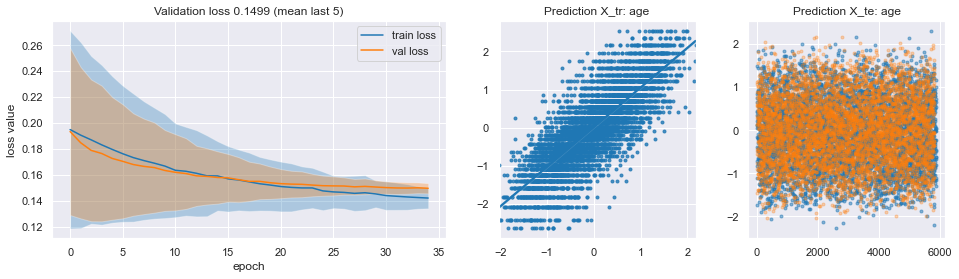

0.142986 0.149873 0.006887000000000004
0002/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


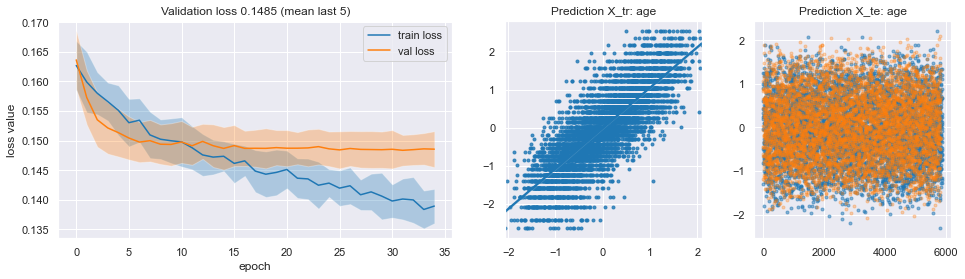

0.139452 0.148508 0.009056000000000008
0003/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


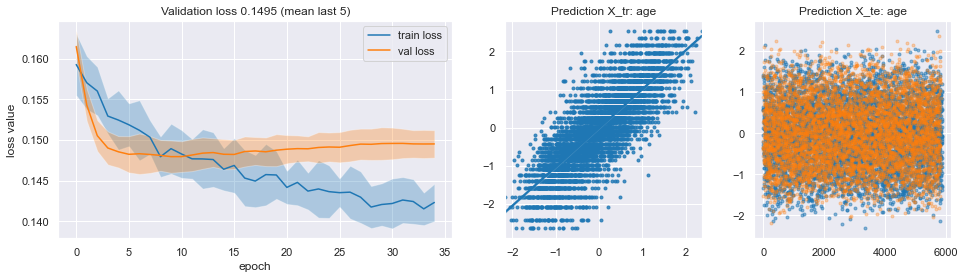

0.142218 0.149544 0.007325999999999999
0004/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


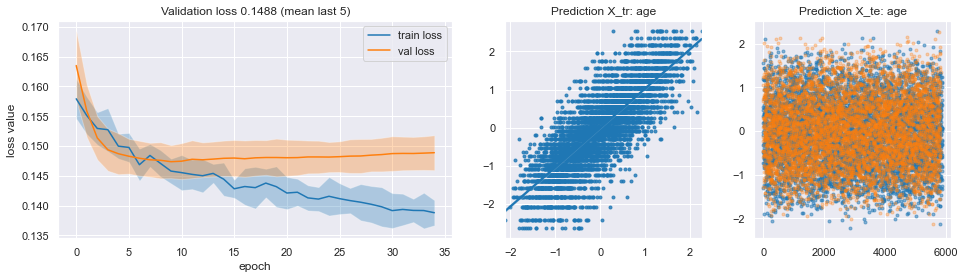

0.13912 0.148767 0.009647000000000017
0005/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


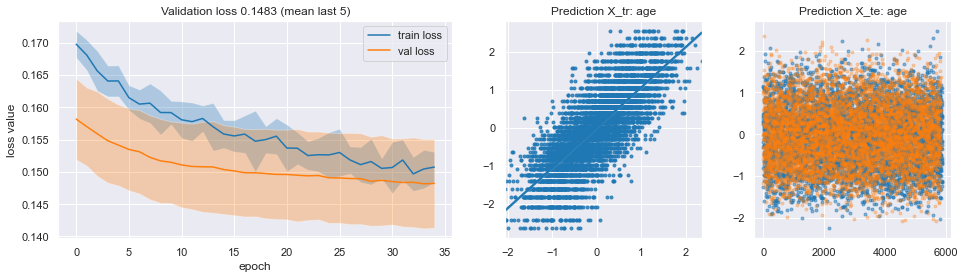

0.15068 0.148326 -0.002353999999999995
0006/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


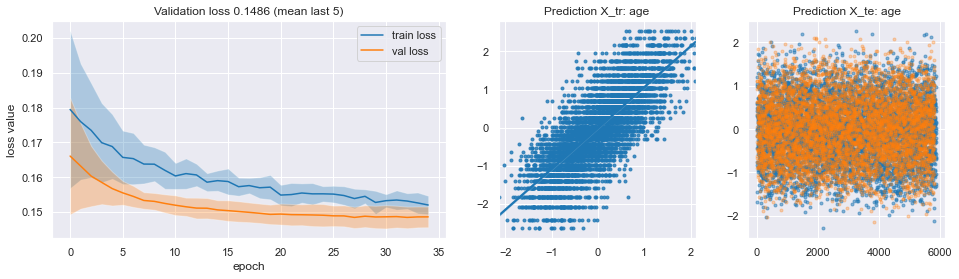

0.152894 0.148592 -0.004302
0007/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


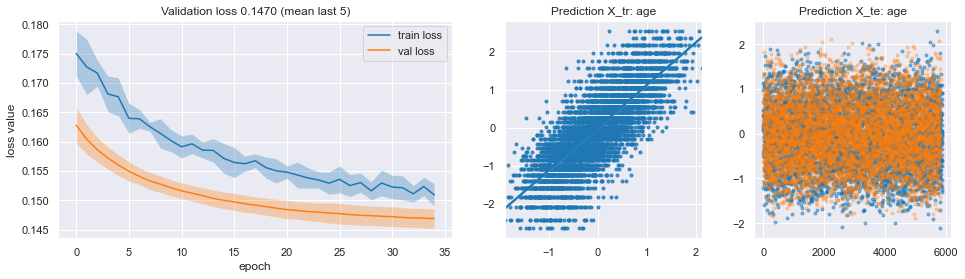

0.151754 0.147021 -0.004732999999999987
0008/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 0, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


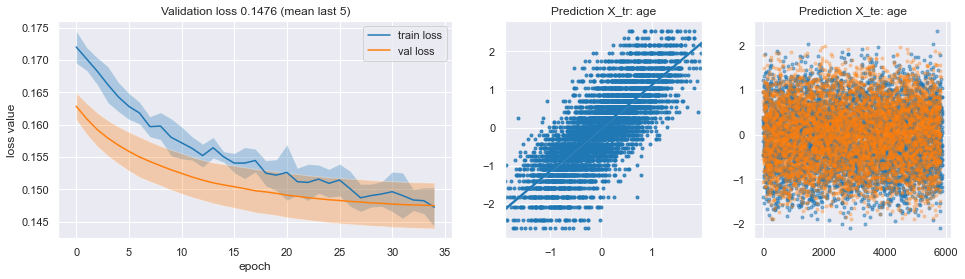

0.148509 0.147604 -0.0009049999999999891



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
6,0.151754,0.147021,64,40,sigmoid,0.2,"(64,)",987,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()
7,0.148509,0.147604,64,40,sigmoid,0.2,"(64,)",1008,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),PowerTransformer()
4,0.150680,0.148326,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,0,True,True,None,RobustScaler()
1,0.139452,0.148508,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,0,True,True,None,PowerTransformer()
5,0.152894,0.148592,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,0,True,True,None,PowerTransformer()
3,0.139120,0.148767,64,40,sigmoid,0.2,"(128, 32)",1008,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),PowerTransformer()
2,0.142218,0.149544,64,40,sigmoid,0.2,"(128, 32)",987,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()
0,0.142986,0.149873,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,0,True,True,None,RobustScaler()


Starting with dataset short_merge - target: domain1_var1
Removing 435 missing values from target dataset.
Size of dataset:  (5390, 1654)
8 grid points will be checked!

---Start_Grid_Exploration---



0001/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


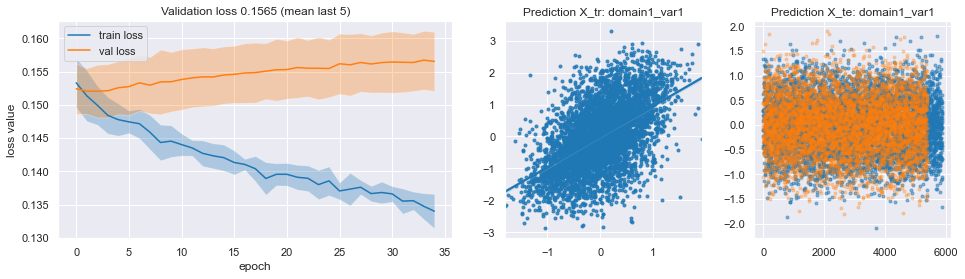

0.135285 0.156503 0.021218000000000015
0002/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


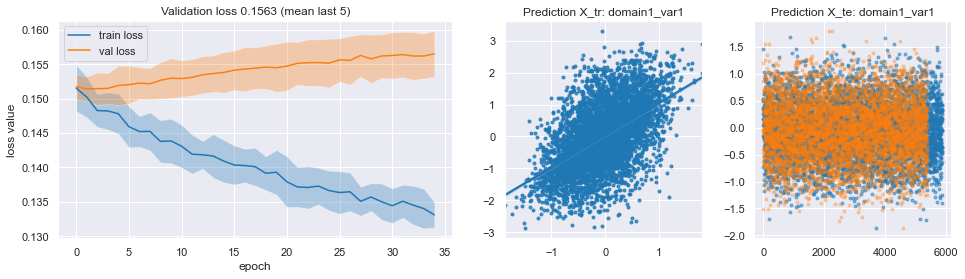

0.134237 0.156333 0.022096000000000005
0003/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


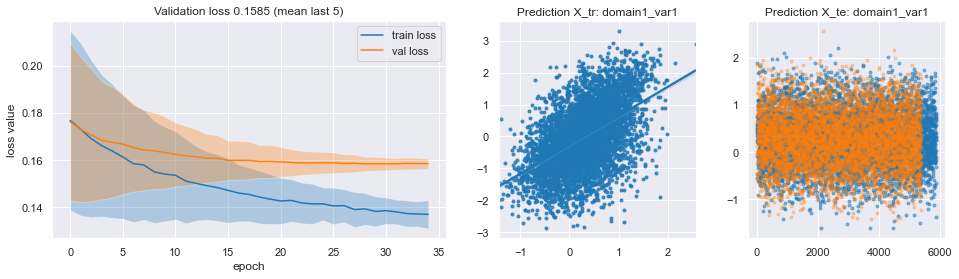

0.137685 0.158512 0.020826999999999984
0004/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


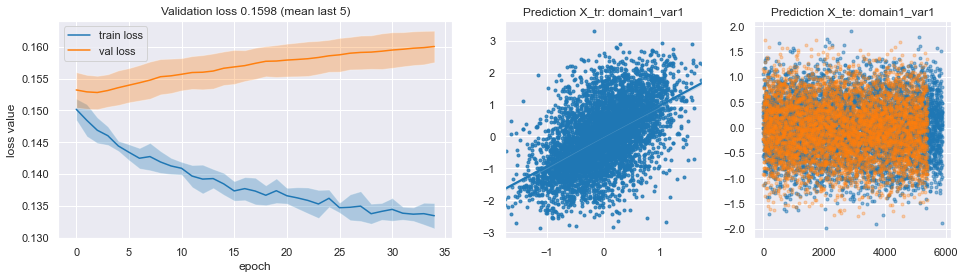

0.133853 0.159761 0.025907999999999987
0005/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


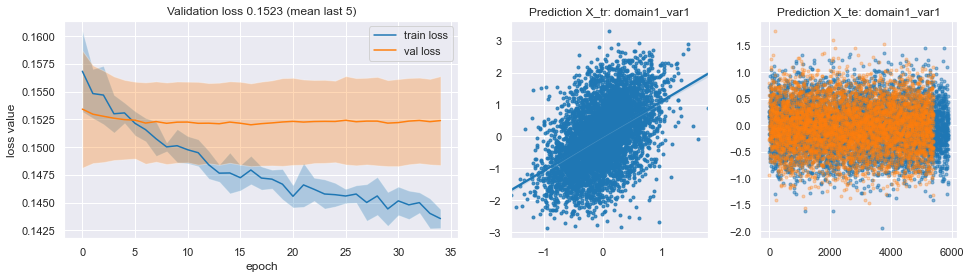

0.144514 0.152332 0.007817999999999992
0006/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


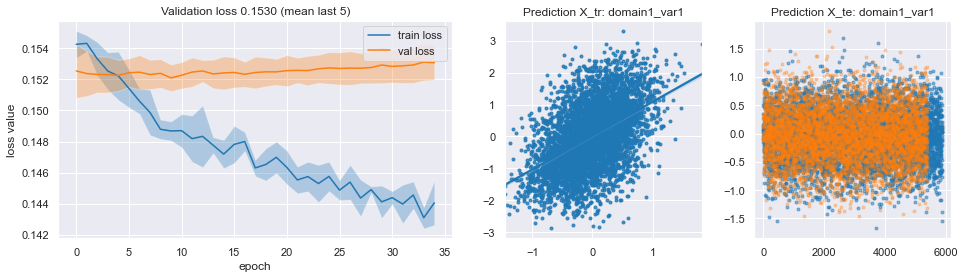

0.14402 0.152961 0.008941000000000004
0007/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


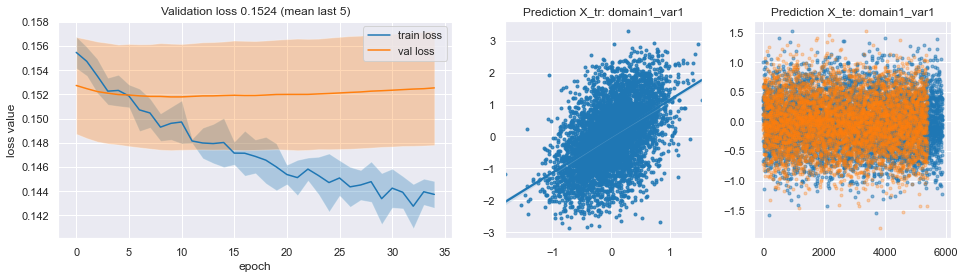

0.14372 0.152439 0.008719000000000005
0008/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 1, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


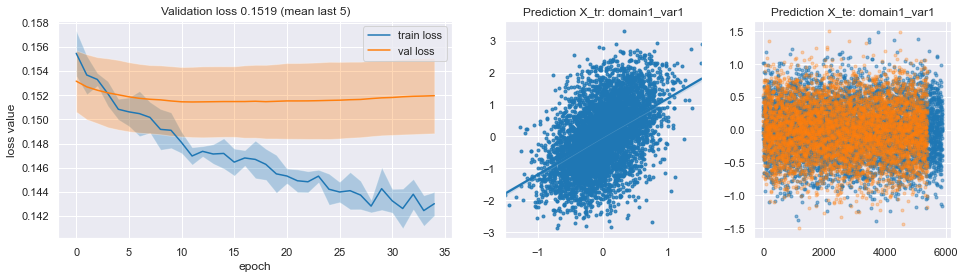

0.143032 0.151892 0.008860000000000007



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
7,0.143032,0.151892,64,40,sigmoid,0.2,"(64,)",1002,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()
4,0.144514,0.152332,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,1,True,True,None,RobustScaler()
6,0.143720,0.152439,64,40,sigmoid,0.2,"(64,)",981,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),RobustScaler()
5,0.144020,0.152961,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,1,True,True,None,PowerTransformer()
1,0.134237,0.156333,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,1,True,True,None,PowerTransformer()
0,0.135285,0.156503,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,1,True,True,None,RobustScaler()
2,0.137685,0.158512,64,40,sigmoid,0.2,"(128, 32)",981,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),RobustScaler()
3,0.133853,0.159761,64,40,sigmoid,0.2,"(128, 32)",1002,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()


Starting with dataset short_merge - target: domain1_var2
Removing 435 missing values from target dataset.
Size of dataset:  (5390, 1654)
8 grid points will be checked!

---Start_Grid_Exploration---



0001/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


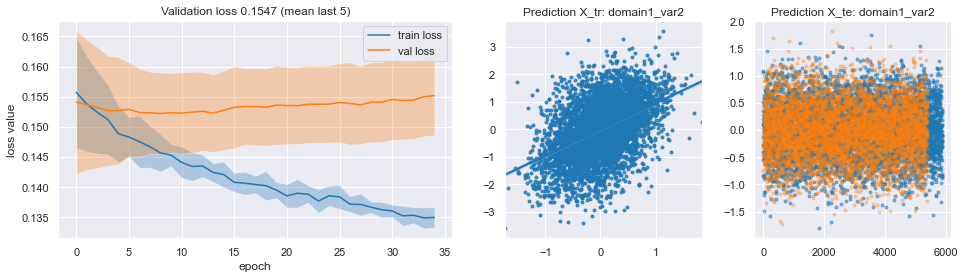

0.1353 0.154701 0.019401
0002/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


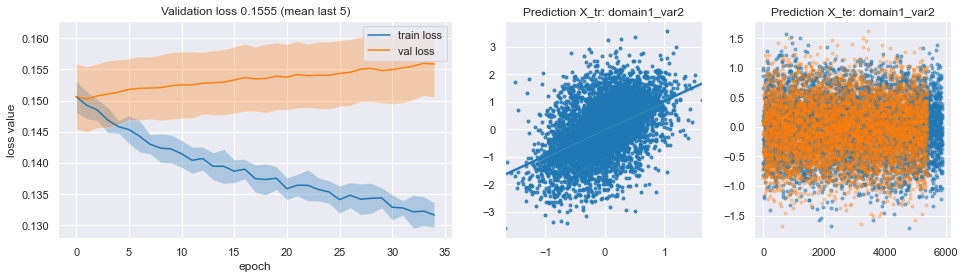

0.132373 0.155517 0.023143999999999998
0003/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


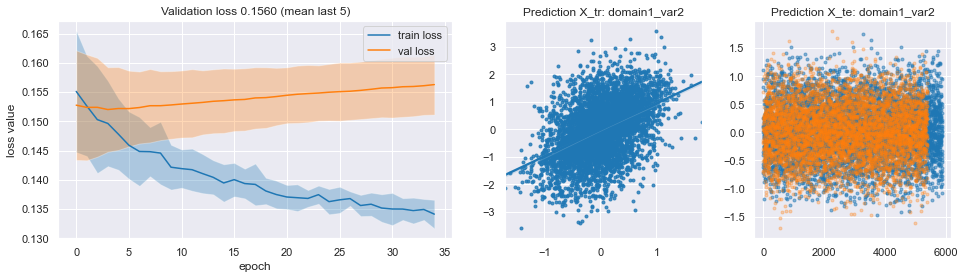

0.134757 0.155997 0.02124000000000001
0004/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


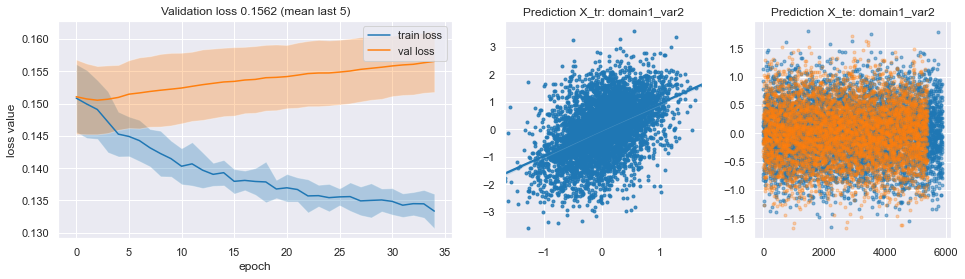

0.134282 0.156161 0.021878999999999982
0005/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


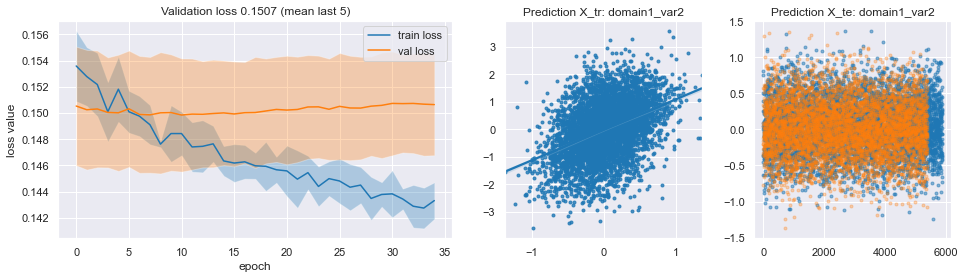

0.143247 0.150705 0.007457999999999992
0006/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


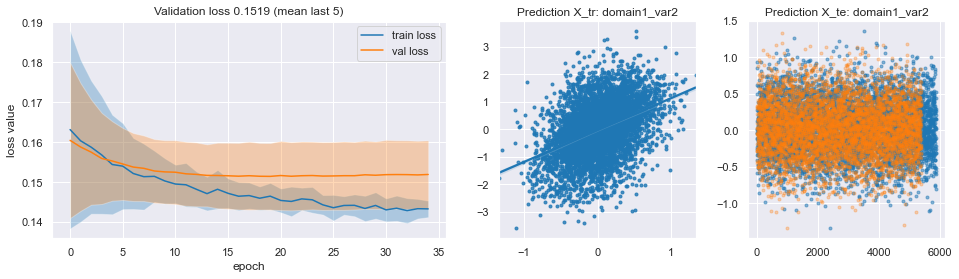

0.143202 0.151873 0.008671000000000012
0007/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


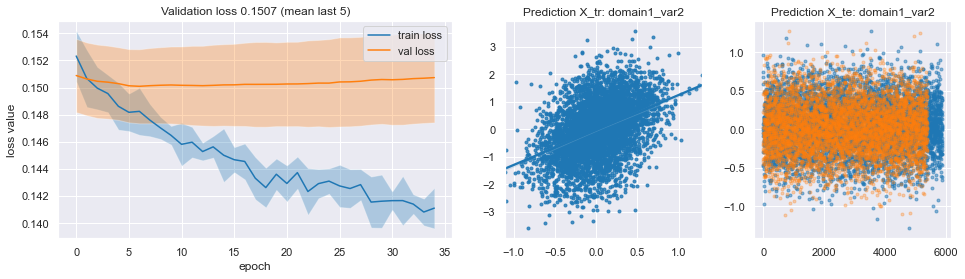

0.141337 0.150655 0.00931800000000002
0008/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 2, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


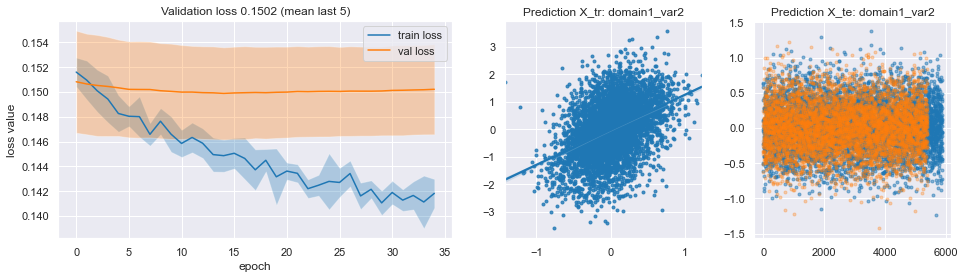

0.141558 0.150167 0.008609000000000006



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
7,0.141558,0.150167,64,40,sigmoid,0.2,"(64,)",1002,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),PowerTransformer()
6,0.141337,0.150655,64,40,sigmoid,0.2,"(64,)",981,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),RobustScaler()
4,0.143247,0.150705,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,2,True,True,None,RobustScaler()
5,0.143202,0.151873,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,2,True,True,None,PowerTransformer()
0,0.135300,0.154701,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,2,True,True,None,RobustScaler()
1,0.132373,0.155517,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,2,True,True,None,PowerTransformer()
2,0.134757,0.155997,64,40,sigmoid,0.2,"(128, 32)",981,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),RobustScaler()
3,0.134282,0.156161,64,40,sigmoid,0.2,"(128, 32)",1002,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),PowerTransformer()


Starting with dataset short_merge - target: domain2_var1
Removing 39 missing values from target dataset.
Size of dataset:  (5786, 1654)
8 grid points will be checked!

---Start_Grid_Exploration---



0001/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


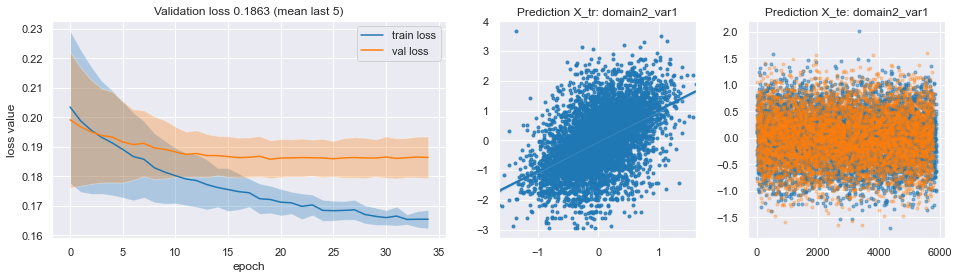

0.165696 0.186305 0.02060899999999999
0002/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


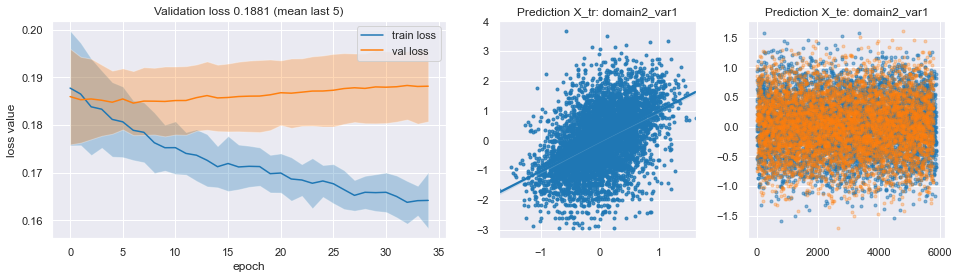

0.16462 0.188107 0.023487000000000008
0003/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


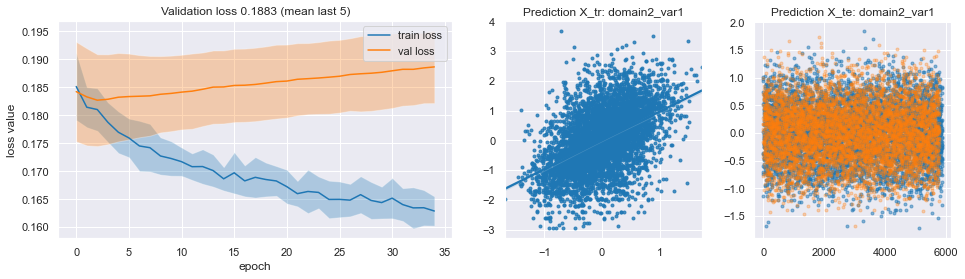

0.163794 0.188314 0.024520000000000014
0004/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


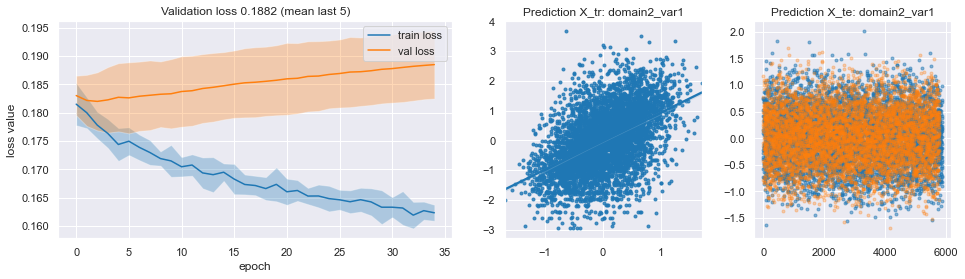

0.162692 0.188156 0.025463999999999987
0005/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


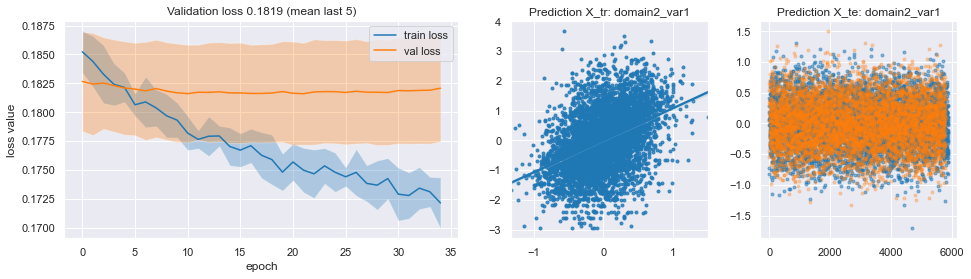

0.172877 0.181919 0.009041999999999994
0006/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


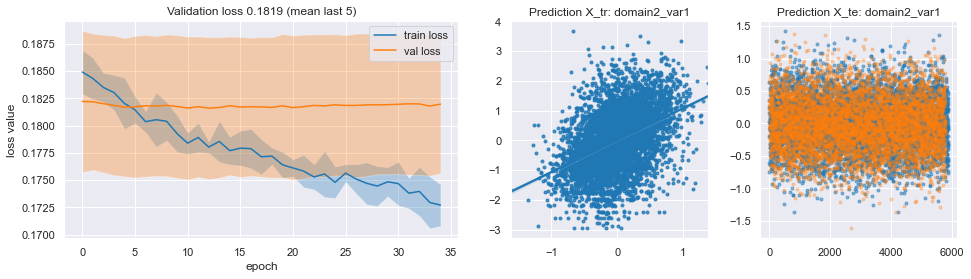

0.173617 0.181934 0.008317000000000019
0007/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


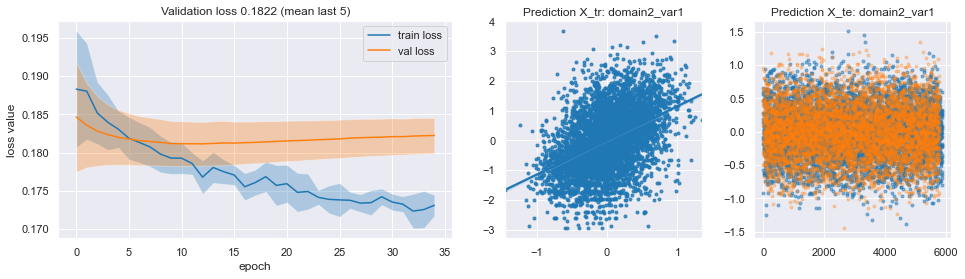

0.172952 0.18215 0.009198000000000012
0008/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 3, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


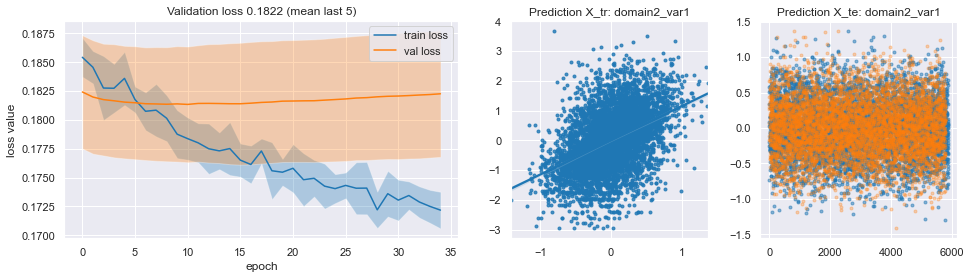

0.172817 0.18216 0.00934299999999999



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
4,0.172877,0.181919,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,3,True,True,None,RobustScaler()
5,0.173617,0.181934,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,3,True,True,None,PowerTransformer()
6,0.172952,0.182150,64,40,sigmoid,0.2,"(64,)",987,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),RobustScaler()
7,0.172817,0.182160,64,40,sigmoid,0.2,"(64,)",1008,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),PowerTransformer()
0,0.165696,0.186305,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,3,True,True,None,RobustScaler()
1,0.164620,0.188107,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,3,True,True,None,PowerTransformer()
3,0.162692,0.188156,64,40,sigmoid,0.2,"(128, 32)",1008,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),PowerTransformer()
2,0.163794,0.188314,64,40,sigmoid,0.2,"(128, 32)",987,uniform,1,adagrad,3,True,True,PCA(n_components=0.99),RobustScaler()


Starting with dataset short_merge - target: domain2_var2
Removing 39 missing values from target dataset.
Size of dataset:  (5786, 1654)
8 grid points will be checked!

---Start_Grid_Exploration---



0001/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


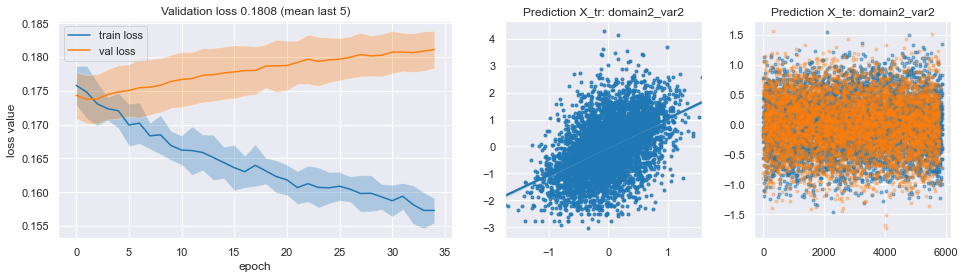

0.15818 0.180814 0.022634000000000015
0002/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


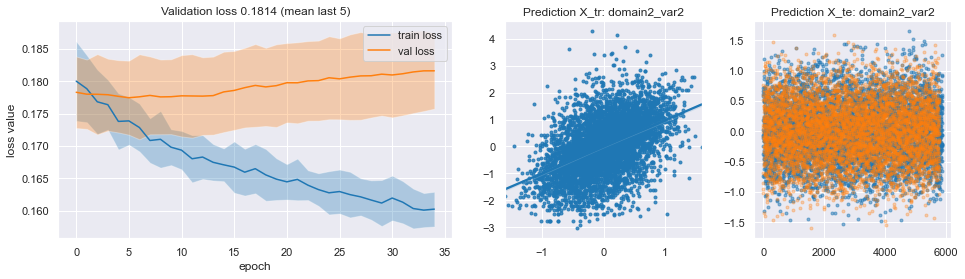

0.160794 0.181362 0.020568000000000003
0003/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


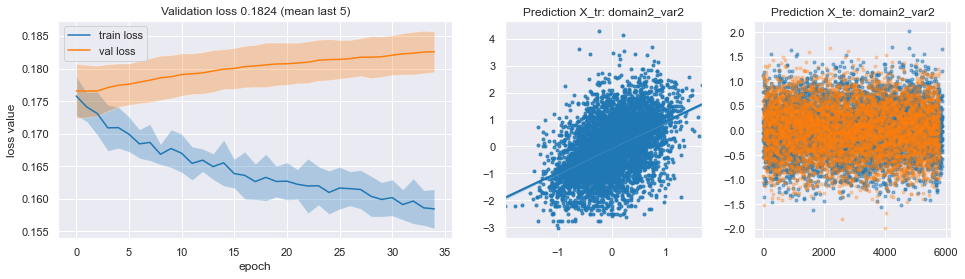

0.159204 0.182363 0.023158999999999985
0004/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (128, 32), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


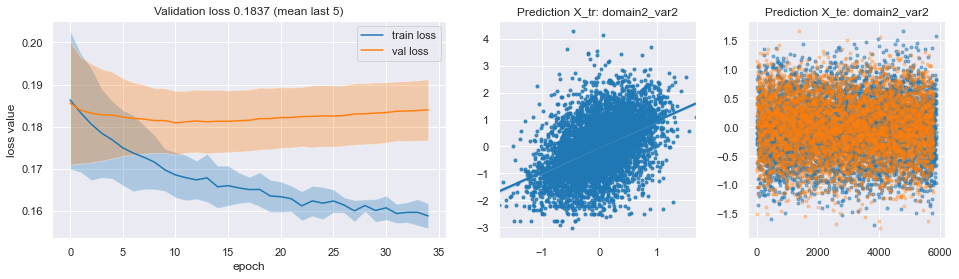

0.159633 0.183706 0.02407300000000001
0005/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': RobustScaler()}


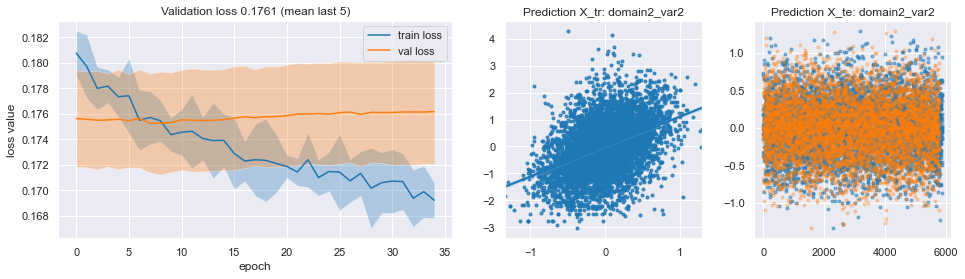

0.169968 0.17613 0.006162000000000001
0006/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': None, 'scaler': PowerTransformer()}


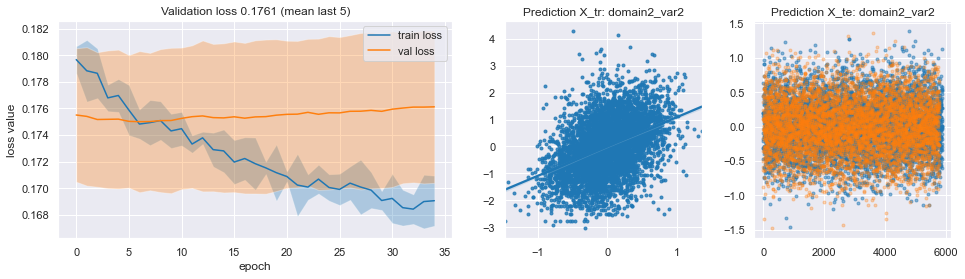

0.168864 0.176062 0.00719800000000001
0007/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': RobustScaler()}


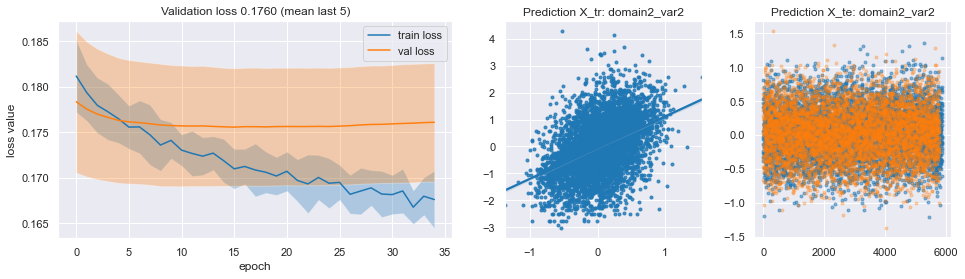

0.167816 0.176021 0.008205000000000018
0008/0008 {'batch_size': 64, 'epochs': 40, 'nn__activation': 'sigmoid', 'nn__dropout': 0.2, 'nn__hidden': (64,), 'nn__input_size': 1654, 'nn__kernel_initializer': 'uniform', 'nn__num_targets': 1, 'nn__optimizer': 'adagrad', 'nn__tidx': 4, 'nn__use_batch': True, 'nn__use_dropout': True, 'pca': PCA(n_components=0.99), 'scaler': PowerTransformer()}


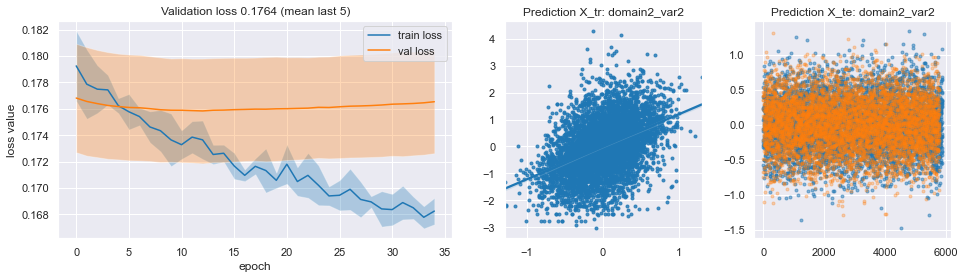

0.168353 0.17642 0.00806699999999999



,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
6,0.167816,0.176021,64,40,sigmoid,0.2,"(64,)",987,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),RobustScaler()
5,0.168864,0.176062,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,4,True,True,None,PowerTransformer()
4,0.169968,0.176130,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,4,True,True,None,RobustScaler()
7,0.168353,0.176420,64,40,sigmoid,0.2,"(64,)",1008,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),PowerTransformer()
0,0.158180,0.180814,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,4,True,True,None,RobustScaler()
1,0.160794,0.181362,64,40,sigmoid,0.2,"(128, 32)",1654,uniform,1,adagrad,4,True,True,None,PowerTransformer()
2,0.159204,0.182363,64,40,sigmoid,0.2,"(128, 32)",987,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),RobustScaler()
3,0.159633,0.183706,64,40,sigmoid,0.2,"(128, 32)",1008,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),PowerTransformer()


,tr_mean,te_mean,batch_size,epochs,nn__activation,nn__dropout,nn__hidden,nn__input_size,nn__kernel_initializer,nn__num_targets,nn__optimizer,nn__tidx,nn__use_batch,nn__use_dropout,pca,scaler
0,0.151754,0.147021,64,40,sigmoid,0.2,"(64,)",987,uniform,1,adagrad,0,True,True,PCA(n_components=0.99),RobustScaler()
1,0.143032,0.151892,64,40,sigmoid,0.2,"(64,)",1002,uniform,1,adagrad,1,True,True,PCA(n_components=0.99),PowerTransformer()
2,0.141558,0.150167,64,40,sigmoid,0.2,"(64,)",1002,uniform,1,adagrad,2,True,True,PCA(n_components=0.99),PowerTransformer()
3,0.172877,0.181919,64,40,sigmoid,0.2,"(64,)",1654,uniform,1,adagrad,3,True,True,None,RobustScaler()
4,0.167816,0.176021,64,40,sigmoid,0.2,"(64,)",987,uniform,1,adagrad,4,True,True,PCA(n_components=0.99),RobustScaler()


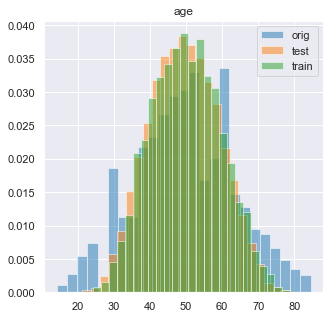

/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/anaconda3/envs/neuro/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


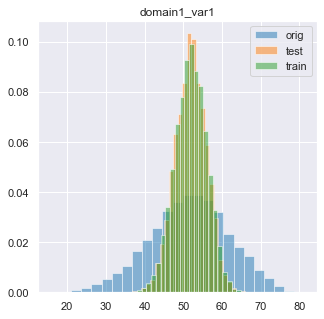

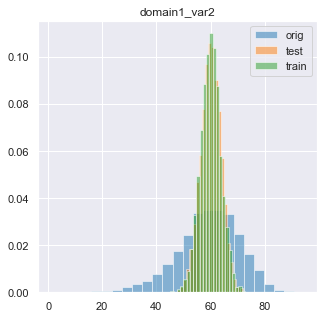

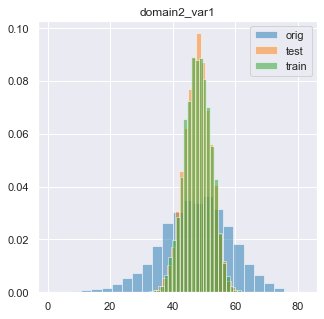

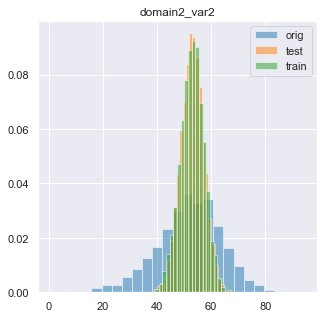

Score: 0.1596 | 0.1470 0.1519 0.1502 0.1819 0.1760


In [23]:
datasets_to_check = ['short_merge']

for dataset_id in datasets_to_check:

    predictions = {}
    scores = []
    grids = []
    
    for tidx, target in enumerate(['age', 'domain1_var1', 'domain1_var2', 'domain2_var1', 'domain2_var2']):

        print('Starting with dataset %s - target: %s' % (dataset_id, target))
        pred_tr, pred_te, top_grid, idx, df_grid = run_prediction(
            targets, dataset_id=dataset_id, target=target, tidx=tidx)
        
        predictions['%s_tr' % target] = pred_tr
        predictions['%s_te' % target] = pred_te
        predictions['%s_miss' % target] = idx
        
        scores.append(top_grid['te_mean'])
        grids.append(top_grid)

    # Display grids summary
    grid_summary = pd.concat([pd.DataFrame(g).T for g in grids]).reset_index().drop(columns='index')
    display(grid_summary)
    
    # Compute overall score
    weights = [.3, .175, .175, .175, .175]
    score = np.sum([s * weights[i] for i, s in enumerate(scores)])
    score_postfix = [int(score*10000)] + [int(s*10000) for i, s in enumerate(scores)]

    df_results_tr, df_results_te = save_results(
        predictions, scaler_targets, targets, test_id, feature_transform,
        sample_submission, dataset_id, score_postfix)

    plot_prediction_distributions(targets, scaler_targets, df_results_tr, df_results_te)
    
    # Feedback of overall score
    txt = 'Score: {:.4f} | {:.4f} {:.4f} {:.4f} {:.4f} {:.4f}'.format(score, *scores)
    print(txt)